# <center>PRÁCTICA 1: APRENDIZAJE NO SUPERVISADO (DengAI)<center>

**Nombre y apellidos:** Alex Anthony Prieto Romani

**Usuario VIU:** aprietor@student.universidadviu.com

---
# Resumen
---

Este conjunto de datos proporciona información en una escala de tiempo definida por el año (`year`) y la semana del año (`weekofyear`). Las unidades, cuando aplican, se indican como sufijo en el nombre de la característica (`_unit`).

**Indicadores de Ciudad y Fecha:**

*   `city`: Abreviatura de la ciudad (sj para San Juan, iq para Iquitos).
*   `week_start_date`: Fecha de inicio de la semana en formato aaaa-mm-dd.

**Mediciones de la Estación Meteorológica (Datos Climáticos Diarios GHCN de la NOAA):**

*   `station_max_temp_c`: Temperatura máxima (°C).
*   `station_min_temp_c`: Temperatura mínima (°C).
*   `station_avg_temp_c`: Temperatura media (°C).
*   `station_precip_mm`: Precipitación total (mm).
*   `station_diur_temp_rng_c`: Rango de temperatura diurna (°C).

**Mediciones de Precipitación por Satélite PERSIANN (escala de 0,25x0,25 grados):**

*   `precipitation_amt_mm`: Precipitación total (mm).

**Mediciones de Reanálisis del Sistema de Pronóstico Climático NCEP de la NOAA (escala de 0,5 x 0,5 grados):**

*   `reanalysis_sat_precip_amt_mm`: Precipitación total (mm).
*   `reanalysis_dew_point_temp_k`: Temperatura media del punto de rocío (K).
*   `reanalysis_air_temp_k`: Temperatura media del aire (K).
*   `reanalysis_relative_humidity_percent`: Humedad relativa media (%).
*   `reanalysis_specific_humidity_g_per_kg`: Humedad específica media (g/kg).
*   `reanalysis_precip_amt_kg_per_m2`: Precipitación total (kg/m²).
*   `reanalysis_max_air_temp_k`: Temperatura máxima del aire (K).
*   `reanalysis_min_air_temp_k`: Temperatura mínima del aire (K).
*   `reanalysis_avg_temp_k`: Temperatura media del aire (K).
*   `reanalysis_tdtr_k`: Rango de temperatura diurna (K).

**Vegetación Satelital - Índice de Vegetación de Diferencia Normalizada (NDVI) - Mediciones del Índice de Vegetación de Diferencia Normalizada CDR de la NOAA (escala de 0,5 x 0,5 grados):**

*   `ndvi_ne`: NDVI del píxel al noreste del centroide de la ciudad.
*   `ndvi_nw`: NDVI del píxel al noroeste del centroide de la ciudad.
*   `ndvi_se`: NDVI del píxel al sureste del centroide de la ciudad.
*   `ndvi_sw`: NDVI del píxel al suroeste del centroide de la ciudad.

---
# Inicialización
---

In [48]:
# Imports generales
import pandas as pd
import io
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import seaborn as sns
from sklearn import preprocessing
from sklearn.impute import KNNImputer, SimpleImputer

In [49]:
train = pd.read_csv("dengue_features_train.csv")

print(train.shape)
train.head()

(1456, 24)


,city,year,weekofyear,week_start_date,ndvi_ne,ndvi_nw,ndvi_se,ndvi_sw,precipitation_amt_mm,reanalysis_air_temp_k,...,reanalysis_precip_amt_kg_per_m2,reanalysis_relative_humidity_percent,reanalysis_sat_precip_amt_mm,reanalysis_specific_humidity_g_per_kg,reanalysis_tdtr_k,station_avg_temp_c,station_diur_temp_rng_c,station_max_temp_c,station_min_temp_c,station_precip_mm
0,sj,1990,18,1990-04-30,0.122600,0.103725,0.198483,0.177617,12.42,297.572857,...,32.00,73.365714,12.42,14.012857,2.628571,25.442857,6.900000,29.4,20.0,16.0
1,sj,1990,19,1990-05-07,0.169900,0.142175,0.162357,0.155486,22.82,298.211429,...,17.94,77.368571,22.82,15.372857,2.371429,26.714286,6.371429,31.7,22.2,8.6
2,sj,1990,20,1990-05-14,0.032250,0.172967,0.157200,0.170843,34.54,298.781429,...,26.10,82.052857,34.54,16.848571,2.300000,26.714286,6.485714,32.2,22.8,41.4
3,sj,1990,21,1990-05-21,0.128633,0.245067,0.227557,0.235886,15.36,298.987143,...,13.90,80.337143,15.36,16.672857,2.428571,27.471429,6.771429,33.3,23.3,4.0
4,sj,1990,22,1990-05-28,0.196200,0.262200,0.251200,0.247340,7.52,299.518571,...,12.20,80.460000,7.52,17.210000,3.014286,28.942857,9.371429,35.0,23.9,5.8


---
# Exploración
---

## 2.1 Pre procesado

In [50]:
# Verificar columnas
train.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1456 entries, 0 to 1455
Data columns (total 24 columns):
 #   Column                                 Non-Null Count  Dtype  
---  ------                                 --------------  -----  
 0   city                                   1456 non-null   object 
 1   year                                   1456 non-null   int64  
 2   weekofyear                             1456 non-null   int64  
 3   week_start_date                        1456 non-null   object 
 4   ndvi_ne                                1262 non-null   float64
 5   ndvi_nw                                1404 non-null   float64
 6   ndvi_se                                1434 non-null   float64
 7   ndvi_sw                                1434 non-null   float64
 8   precipitation_amt_mm                   1443 non-null   float64
 9   reanalysis_air_temp_k                  1446 non-null   float64
 10  reanalysis_avg_temp_k                  1446 non-null   float64
 11  rean

In [51]:
train.describe()

,year,weekofyear,ndvi_ne,ndvi_nw,ndvi_se,ndvi_sw,precipitation_amt_mm,reanalysis_air_temp_k,reanalysis_avg_temp_k,reanalysis_dew_point_temp_k,...,reanalysis_precip_amt_kg_per_m2,reanalysis_relative_humidity_percent,reanalysis_sat_precip_amt_mm,reanalysis_specific_humidity_g_per_kg,reanalysis_tdtr_k,station_avg_temp_c,station_diur_temp_rng_c,station_max_temp_c,station_min_temp_c,station_precip_mm
count,1456.000000,1456.000000,1262.000000,1404.000000,1434.000000,1434.000000,1443.000000,1446.000000,1446.000000,1446.000000,...,1446.000000,1446.000000,1443.000000,1446.000000,1446.000000,1413.000000,1413.000000,1436.000000,1442.000000,1434.000000
mean,2001.031593,26.503434,0.142294,0.130553,0.203783,0.202305,45.760388,298.701852,299.225578,295.246356,...,40.151819,82.161959,45.760388,16.746427,4.903754,27.185783,8.059328,32.452437,22.102150,39.326360
std,5.408314,15.019437,0.140531,0.119999,0.073860,0.083903,43.715537,1.362420,1.261715,1.527810,...,43.434399,7.153897,43.715537,1.542494,3.546445,1.292347,2.128568,1.959318,1.574066,47.455314
min,1990.000000,1.000000,-0.406250,-0.456100,-0.015533,-0.063457,0.000000,294.635714,294.892857,289.642857,...,0.000000,57.787143,0.000000,11.715714,1.357143,21.400000,4.528571,26.700000,14.700000,0.000000
25%,1997.000000,13.750000,0.044950,0.049217,0.155087,0.144209,9.800000,297.658929,298.257143,294.118929,...,13.055000,77.177143,9.800000,15.557143,2.328571,26.300000,6.514286,31.100000,21.100000,8.700000
50%,2002.000000,26.500000,0.128817,0.121429,0.196050,0.189450,38.340000,298.646429,299.289286,295.640714,...,27.245000,80.301429,38.340000,17.087143,2.857143,27.414286,7.300000,32.800000,22.200000,23.850000
75%,2005.000000,39.250000,0.248483,0.216600,0.248846,0.246982,70.235000,299.833571,300.207143,296.460000,...,52.200000,86.357857,70.235000,17.978214,7.625000,28.157143,9.566667,33.900000,23.300000,53.900000
max,2010.000000,53.000000,0.508357,0.454429,0.538314,0.546017,390.600000,302.200000,302.928571,298.450000,...,570.500000,98.610000,390.600000,20.461429,16.028571,30.800000,15.800000,42.200000,25.600000,543.300000


In [52]:
for columna in train.columns:
    print(f"Columns {columna}")
    print(train[columna].unique()[:5])

Columns city
['sj' 'iq']
Columns year
[1990 1991 1992 1993 1994]
Columns weekofyear
[18 19 20 21 22]
Columns week_start_date
['1990-04-30' '1990-05-07' '1990-05-14' '1990-05-21' '1990-05-28']
Columns ndvi_ne
[0.1226    0.1699    0.03225   0.1286333 0.1962   ]
Columns ndvi_nw
[0.103725  0.142175  0.1729667 0.2450667 0.2622   ]
Columns ndvi_se
[0.1984833 0.1623571 0.1572    0.2275571 0.2512   ]
Columns ndvi_sw
[0.1776167 0.1554857 0.1708429 0.2358857 0.24734  ]
Columns precipitation_amt_mm
[12.42 22.82 34.54 15.36  7.52]
Columns reanalysis_air_temp_k
[297.57285714 298.21142857 298.78142857 298.98714286 299.51857143]
Columns reanalysis_avg_temp_k
[297.74285714 298.44285714 298.87857143 299.22857143 299.66428571]
Columns reanalysis_dew_point_temp_k
[292.41428571 293.95142857 295.43428571 295.31       295.82142857]
Columns reanalysis_max_air_temp_k
[299.8 300.9 300.5 301.4 301.9]
Columns reanalysis_min_air_temp_k
[295.9 296.4 297.3 297.  297.5]
Columns reanalysis_precip_amt_kg_per_m2
[32.  

- Convirtiendo valores object a númericos

In [53]:
# Convertir 'week_start_date' a datetime y extraer nuevas características
train['week_start_date'] = pd.to_datetime(train['week_start_date'])
train['day'] = train['week_start_date'].dt.day
train['month'] = train['week_start_date'].dt.month

# Eliminar la columna original de fecha si no es necesaria
train.drop(columns=['week_start_date'], inplace=True)


train.head()

,city,year,weekofyear,ndvi_ne,ndvi_nw,ndvi_se,ndvi_sw,precipitation_amt_mm,reanalysis_air_temp_k,reanalysis_avg_temp_k,...,reanalysis_sat_precip_amt_mm,reanalysis_specific_humidity_g_per_kg,reanalysis_tdtr_k,station_avg_temp_c,station_diur_temp_rng_c,station_max_temp_c,station_min_temp_c,station_precip_mm,day,month
0,sj,1990,18,0.122600,0.103725,0.198483,0.177617,12.42,297.572857,297.742857,...,12.42,14.012857,2.628571,25.442857,6.900000,29.4,20.0,16.0,30,4
1,sj,1990,19,0.169900,0.142175,0.162357,0.155486,22.82,298.211429,298.442857,...,22.82,15.372857,2.371429,26.714286,6.371429,31.7,22.2,8.6,7,5
2,sj,1990,20,0.032250,0.172967,0.157200,0.170843,34.54,298.781429,298.878571,...,34.54,16.848571,2.300000,26.714286,6.485714,32.2,22.8,41.4,14,5
3,sj,1990,21,0.128633,0.245067,0.227557,0.235886,15.36,298.987143,299.228571,...,15.36,16.672857,2.428571,27.471429,6.771429,33.3,23.3,4.0,21,5
4,sj,1990,22,0.196200,0.262200,0.251200,0.247340,7.52,299.518571,299.664286,...,7.52,17.210000,3.014286,28.942857,9.371429,35.0,23.9,5.8,28,5


### 2.1.1. Verificación de valores vacios

In [54]:
# Porcentaje de valores perdidos para cada columna
nulos_porcentaje = train.isnull().sum() / len(train) * 100
nulos_porcentaje.sort_values(ascending=False, inplace=True)
nulos_porcentaje

ndvi_ne                                  13.324176
ndvi_nw                                   3.571429
station_diur_temp_rng_c                   2.953297
station_avg_temp_c                        2.953297
ndvi_sw                                   1.510989
ndvi_se                                   1.510989
station_precip_mm                         1.510989
station_max_temp_c                        1.373626
station_min_temp_c                        0.961538
precipitation_amt_mm                      0.892857
reanalysis_sat_precip_amt_mm              0.892857
reanalysis_precip_amt_kg_per_m2           0.686813
reanalysis_air_temp_k                     0.686813
reanalysis_specific_humidity_g_per_kg     0.686813
reanalysis_relative_humidity_percent      0.686813
reanalysis_max_air_temp_k                 0.686813
reanalysis_avg_temp_k                     0.686813
reanalysis_dew_point_temp_k               0.686813
reanalysis_tdtr_k                         0.686813
reanalysis_min_air_temp_k      

### 2.1.2. Verificación de outliers

In [55]:
# Función para imprimir el resumen de outliers
def summarize_outliers(df, show_summary=False):

    # Función para tratar outliers usando el rango intercuartílico
    def handle_outliers(column):
        # Eliminar valores nulos antes del cálculo
        Q1 = column.quantile(0.25)
        Q3 = column.quantile(0.75)
        IQR = Q3 - Q1
        outliers = ((column < (Q1 - 1.5 * IQR)) | (column > (Q3 + 1.5 * IQR)))
        return outliers

    # Aplicar la detección de outliers solo a las columnas numéricas
    numeric_cols = df.select_dtypes(include='number').dropna()

    # Aplicar la función de outliers a cada columna
    outliers = numeric_cols.apply(handle_outliers)

    # Contar el número de outliers
    outliers_count = outliers.sum()
    total_rows = df.shape[0]
    outliers_percentage = (outliers_count / total_rows) * 100

    # Crear un DataFrame con el resumen de outliers
    outliers_summary = pd.DataFrame({
        'Outliers Count': outliers_count,
        'Outliers Percentage (%)': outliers_percentage
    })

    # Mostrar el resumen si el usuario lo solicita
    if show_summary:
        print(outliers_summary.sort_values(by='Outliers Count', ascending=False))

    # Retornar el DataFrame de outliers
    return outliers

In [56]:
outliers_inicial = summarize_outliers(train, show_summary=True)

                                       Outliers Count  Outliers Percentage (%)
station_precip_mm                                  72                 4.945055
reanalysis_precip_amt_kg_per_m2                    68                 4.670330
ndvi_sw                                            24                 1.648352
ndvi_se                                            17                 1.167582
precipitation_amt_mm                               17                 1.167582
reanalysis_sat_precip_amt_mm                       17                 1.167582
station_min_temp_c                                 12                 0.824176
reanalysis_dew_point_temp_k                         9                 0.618132
station_avg_temp_c                                  9                 0.618132
station_max_temp_c                                  8                 0.549451
ndvi_ne                                             6                 0.412088
ndvi_nw                                             

In [57]:
#Creando una función para ver los boxplots de las columnas numericas
def plot_numeric_boxplots(df):
    # Seleccionar columnas numéricas
    numeric_columns = df.select_dtypes(include=[np.number]).columns

    # Calcular el número de filas y columnas para los subplots
    n_cols = 5  # Número de columnas por fila
    n_rows = (len(numeric_columns) + n_cols - 1) // n_cols

    # Crear la figura y los subplots
    fig, axes = plt.subplots(n_rows, n_cols, figsize=(3*n_cols, 3*n_rows))

    # Ajustar el espacio entre los subplots
    fig.subplots_adjust(hspace=0.5)

    # Aplanar el array de ejes si es necesario
    axes = axes.flatten() if n_rows > 1 else [axes]

    # Iterar sobre las columnas numéricas
    for i, column in enumerate(numeric_columns):
        # Gráfico de caja
        sns.boxplot(x=df[column], ax=axes[i])
        axes[i].set_title(f'{column}')
        axes[i].set_xlabel('')

    # Ocultar subplots vacíos si los hay
    for j in range(len(numeric_columns), len(axes)):
        axes[j].set_visible(False)

    plt.tight_layout()
    plt.subplots_adjust(top=0.95)
    plt.show()

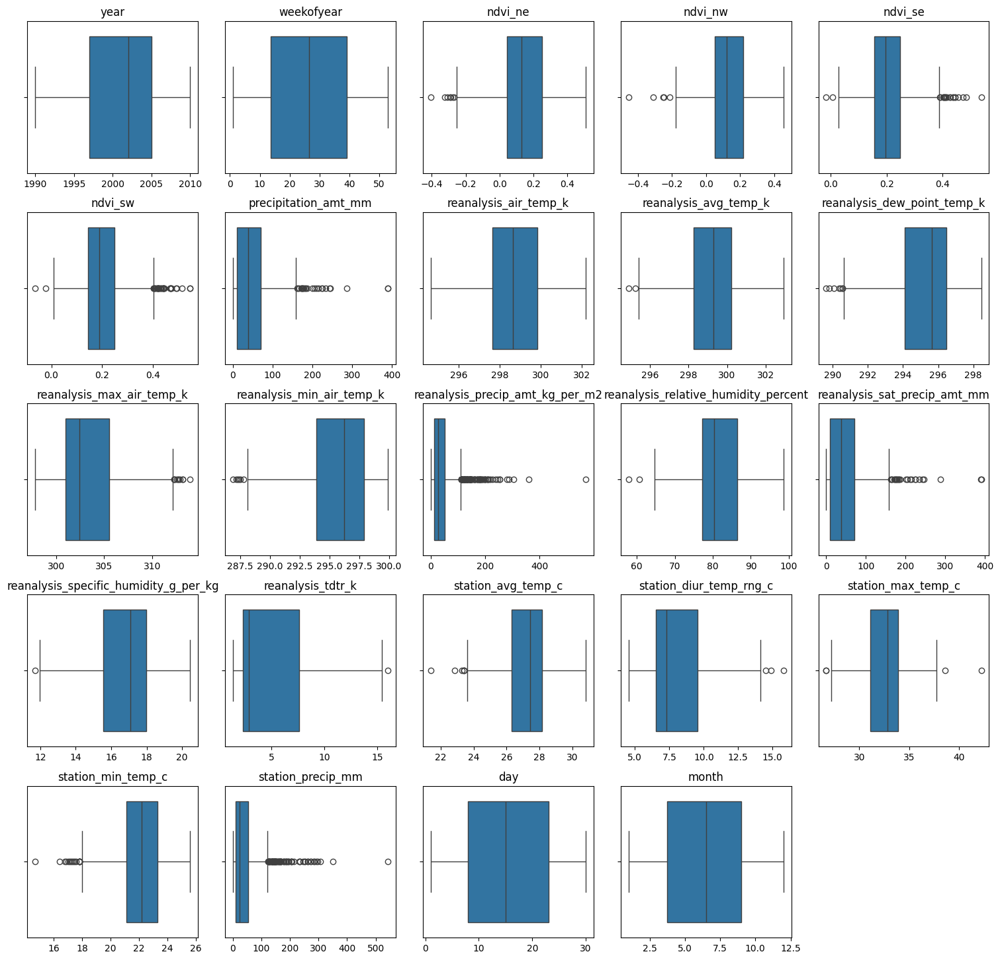

In [58]:
# Verificando graficamente los outliers en cada columna
plot_numeric_boxplots(train)

### 2.1.3. Verificar valores duplicados

In [59]:
# Verificamos si existen valores duplicados
train.duplicated().sum()

np.int64(0)

### 2.1.4. Realizando experimentación para tratamientos de valores vacios y outliers

Se realizará experimentos referentes a la imputación de los valores vacios y como tratarlos:

1.   Experimento 1:

*   Imputación de datos vacíos con KNNImputer.
*   Reimputación de outliers con KNNImputer.

2.   Experimento 2:

*   Eliminación de datos vacíos.
*   Eliminación de outliers.

3.   Experimento 3: Imputación con el promedio y reimputación de outliers

*   Imputar los valores nulos usando el promedio de la columna.
*   Reimputación de outliers con SimpleImputer.

4.   Experimento 4: Imputación con la mediana y reimputación de outliers

*   Imputar los valores nulos usando la mediana de la columna.
*   Reimputación de outliers con SimpleImputer.

5.   Experimento 5: Imputación con KNNImputer y eliminación de outliers

*   Imputación de datos vacíos con KNNImputer.
*   Eliminación de outliers.

In [60]:
train.select_dtypes(exclude=[np.number]).columns

Index(['city'], dtype='object')

In [61]:
train.select_dtypes(include=[np.number]).isna().sum()

year                                       0
weekofyear                                 0
ndvi_ne                                  194
ndvi_nw                                   52
ndvi_se                                   22
ndvi_sw                                   22
precipitation_amt_mm                      13
reanalysis_air_temp_k                     10
reanalysis_avg_temp_k                     10
reanalysis_dew_point_temp_k               10
reanalysis_max_air_temp_k                 10
reanalysis_min_air_temp_k                 10
reanalysis_precip_amt_kg_per_m2           10
reanalysis_relative_humidity_percent      10
reanalysis_sat_precip_amt_mm              13
reanalysis_specific_humidity_g_per_kg     10
reanalysis_tdtr_k                         10
station_avg_temp_c                        43
station_diur_temp_rng_c                   43
station_max_temp_c                        20
station_min_temp_c                        14
station_precip_mm                         22
day       

#### Experimento 1

In [62]:
def experiment_1(df):
    print("Experimento 1: Imputación con KNNImputer y reimputación de outliers")

    # Seleccionar columnas numéricas
    numeric_columns = df.select_dtypes(include=[np.number]).columns
    
    # Extraer los datos numéricos del DataFrame
    numeric_data = df[numeric_columns]
    
    # Imputar valores nulos usando KNNImputer
    imputer = KNNImputer(n_neighbors=5)
    df_imputed = pd.DataFrame(imputer.fit_transform(numeric_data), columns=numeric_columns)

    # Identificar y resumir los outliers
    outliers = summarize_outliers(df_imputed, show_summary=False)

    # Reemplazar outliers por NaN y reimputar
    df_imputed[outliers] = np.nan
    df_imputed = pd.DataFrame(imputer.fit_transform(df_imputed), columns=df_imputed.columns)
    
    # Combinar columnas no numéricas con el DataFrame imputado
    non_numeric_columns = df.select_dtypes(exclude=[np.number]).columns
    df_imputed = pd.concat([df[non_numeric_columns], df_imputed], axis=1)

    # Identificar y resumir los outliers
    print("Verificación de outliers después de realizar el experimento")
    summarize_outliers(df_imputed, show_summary=True)

    return df_imputed

train_experiment_1 = experiment_1(train.copy())

train_experiment_1.columns

Experimento 1: Imputación con KNNImputer y reimputación de outliers
Verificación de outliers después de realizar el experimento
                                       Outliers Count  Outliers Percentage (%)
station_precip_mm                                  13                 0.892857
reanalysis_precip_amt_kg_per_m2                     9                 0.618132
ndvi_sw                                             7                 0.480769
ndvi_se                                             5                 0.343407
precipitation_amt_mm                                4                 0.274725
reanalysis_sat_precip_amt_mm                        4                 0.274725
ndvi_nw                                             0                 0.000000
year                                                0                 0.000000
reanalysis_air_temp_k                               0                 0.000000
weekofyear                                          0                 0.000000
ndv

Index(['city', 'year', 'weekofyear', 'ndvi_ne', 'ndvi_nw', 'ndvi_se',
       'ndvi_sw', 'precipitation_amt_mm', 'reanalysis_air_temp_k',
       'reanalysis_avg_temp_k', 'reanalysis_dew_point_temp_k',
       'reanalysis_max_air_temp_k', 'reanalysis_min_air_temp_k',
       'reanalysis_precip_amt_kg_per_m2',
       'reanalysis_relative_humidity_percent', 'reanalysis_sat_precip_amt_mm',
       'reanalysis_specific_humidity_g_per_kg', 'reanalysis_tdtr_k',
       'station_avg_temp_c', 'station_diur_temp_rng_c', 'station_max_temp_c',
       'station_min_temp_c', 'station_precip_mm', 'day', 'month'],
      dtype='object')

#### Experimento 2

In [63]:
def experiment_2(df):
    print("Experimento 2: Eliminación de datos vacíos y eliminación de outliers")

    # Eliminar filas con valores vacíos
    df_dropped = df.dropna()

    # Calcular outliers en el nuevo df
    outliers_calc = summarize_outliers(df_dropped)

    # Eliminar outliers del df
    df_dropped = df_dropped[~outliers_calc.any(axis=1)]
    
    # Combinar columnas no numéricas con el DataFrame imputado
    non_numeric_columns = df.select_dtypes(exclude=[np.number]).columns
    df_dropped = pd.concat([df[non_numeric_columns], df_dropped], axis=1)

    # Verificar y resumir outliers
    print("Verificación de outliers después de realizar el experimento")
    summarize_outliers(df_dropped, show_summary=True)

    return df_dropped

train_experiment_2 = experiment_2(train.copy())


Experimento 2: Eliminación de datos vacíos y eliminación de outliers
Verificación de outliers después de realizar el experimento
                                       Outliers Count  Outliers Percentage (%)
reanalysis_relative_humidity_percent               43                 2.953297
station_precip_mm                                  36                 2.472527
reanalysis_precip_amt_kg_per_m2                    25                 1.717033
ndvi_sw                                            15                 1.030220
reanalysis_max_air_temp_k                           8                 0.549451
precipitation_amt_mm                                5                 0.343407
reanalysis_sat_precip_amt_mm                        5                 0.343407
ndvi_se                                             4                 0.274725
station_diur_temp_rng_c                             3                 0.206044
reanalysis_min_air_temp_k                           2                 0.137363
re

#### Experimento 3

In [64]:
def experiment_3(df):
    print("Experimento 3: Imputación con el promedio y reimputación de outliers")
    
    # Seleccionar columnas numéricas
    numeric_columns = df.select_dtypes(include=[np.number]).columns
    
    # Extraer los datos numéricos del DataFrame
    numeric_data = df[numeric_columns]

    # Imputar valores nulos usando el promedio
    imputer = SimpleImputer(strategy='mean')
    df_imputed = pd.DataFrame(imputer.fit_transform(numeric_data), columns=numeric_columns)

    # Identificar y resumir los outliers
    outliers = summarize_outliers(df_imputed)

    # Reemplazar outliers por NaN y reimputar
    df_imputed[outliers] = np.nan
    df_imputed = pd.DataFrame(imputer.fit_transform(df_imputed), columns=df_imputed.columns)
    
    # Combinar columnas no numéricas con el DataFrame imputado
    non_numeric_columns = df.select_dtypes(exclude=[np.number]).columns
    df_imputed = pd.concat([df[non_numeric_columns], df_imputed], axis=1)

    # Identificar y resumir los outliers
    print("Verificación de outliers después de realizar el experimento")
    summarize_outliers(df_imputed, show_summary=True)

    return df_imputed

train_experiment_3 = experiment_3(train.copy())

Experimento 3: Imputación con el promedio y reimputación de outliers
Verificación de outliers después de realizar el experimento
                                       Outliers Count  Outliers Percentage (%)
reanalysis_precip_amt_kg_per_m2                    57                 3.914835
station_precip_mm                                  53                 3.640110
ndvi_sw                                            26                 1.785714
ndvi_se                                             7                 0.480769
precipitation_amt_mm                                5                 0.343407
reanalysis_sat_precip_amt_mm                        5                 0.343407
station_avg_temp_c                                  4                 0.274725
ndvi_ne                                             3                 0.206044
reanalysis_max_air_temp_k                           2                 0.137363
year                                                0                 0.000000
we

#### Experimento 4

In [65]:
def experiment_4(df):
    print("Experimento 4: Imputación con la mediana y reimputación de outliers")
    
    # Seleccionar columnas numéricas
    numeric_columns = df.select_dtypes(include=[np.number]).columns
    
    # Extraer los datos numéricos del DataFrame
    numeric_data = df[numeric_columns]

    # Imputar valores nulos usando la mediana
    imputer = SimpleImputer(strategy='median')
    df_imputed = pd.DataFrame(imputer.fit_transform(numeric_data), columns=numeric_columns)

    # Identificar y resumir los outliers
    outliers = summarize_outliers(df_imputed)

    # Reemplazar outliers por NaN y reimputar
    df_imputed[outliers] = np.nan
    df_imputed = pd.DataFrame(imputer.fit_transform(df_imputed), columns=df_imputed.columns)
    
    # Combinar columnas no numéricas con el DataFrame imputado
    non_numeric_columns = df.select_dtypes(exclude=[np.number]).columns
    df_imputed = pd.concat([df[non_numeric_columns], df_imputed], axis=1)

    # Identificar y resumir los outliers
    print("Verificación de outliers después de realizar el experimento")
    summarize_outliers(df_imputed, show_summary=True)

    return df_imputed

train_experiment_4 = experiment_4(train.copy())

Experimento 4: Imputación con la mediana y reimputación de outliers
Verificación de outliers después de realizar el experimento
                                       Outliers Count  Outliers Percentage (%)
reanalysis_precip_amt_kg_per_m2                    57                 3.914835
station_precip_mm                                  53                 3.640110
ndvi_sw                                            26                 1.785714
ndvi_se                                             7                 0.480769
precipitation_amt_mm                                5                 0.343407
reanalysis_sat_precip_amt_mm                        5                 0.343407
station_avg_temp_c                                  4                 0.274725
ndvi_ne                                             3                 0.206044
reanalysis_max_air_temp_k                           2                 0.137363
year                                                0                 0.000000
wee

#### Experimento 5

In [66]:
def experiment_5(df):
    print("Experimento 5: Imputación con KNNImputer y eliminación de outliers")
    
    # Seleccionar columnas numéricas
    numeric_columns = df.select_dtypes(include=[np.number]).columns
    
    # Extraer los datos numéricos del DataFrame
    numeric_data = df[numeric_columns]

    # Imputar valores nulos usando KNNImputer
    imputer = KNNImputer(n_neighbors=5)
    df_imputed = pd.DataFrame(imputer.fit_transform(numeric_data), columns=numeric_columns)

    # Identificar y resumir los outliers
    outliers = summarize_outliers(df_imputed)

    # Eliminar los outliers
    df_imputed = df_imputed[~outliers.any(axis=1)]
    
    # Combinar columnas no numéricas con el DataFrame imputado
    non_numeric_columns = df.select_dtypes(exclude=[np.number]).columns
    df_imputed = pd.concat([df[non_numeric_columns], df_imputed], axis=1)

    # Identificar y resumir los outliers
    print("Verificación de outliers después de realizar el experimento")
    summarize_outliers(df_imputed, show_summary=True)

    return df_imputed

train_experiment_5 = experiment_5(train.copy())

Experimento 5: Imputación con KNNImputer y eliminación de outliers
Verificación de outliers después de realizar el experimento
                                       Outliers Count  Outliers Percentage (%)
reanalysis_relative_humidity_percent              117                 8.035714
reanalysis_max_air_temp_k                          45                 3.090659
station_precip_mm                                  40                 2.747253
reanalysis_precip_amt_kg_per_m2                    36                 2.472527
station_diur_temp_rng_c                            34                 2.335165
ndvi_sw                                            26                 1.785714
reanalysis_tdtr_k                                  26                 1.785714
ndvi_se                                            15                 1.030220
reanalysis_min_air_temp_k                           6                 0.412088
precipitation_amt_mm                                5                 0.343407
rean

In [67]:
train_preproced = train_experiment_1.copy()

Conclusiones:

*   El Experimento 1 parece ser el más equilibrado, ya que la imputación con KNNImputer seguida de la reimputación de outliers mediante el mismo método, ayuda a reducir los outliers sin eliminar datos valiosos. Aunque algunos outliers permanecen, este método parece mantener un buen balance entre la conservación de la información y la reducción de valores extremos.

*   En comparación, la eliminación de datos (Experimento 2 y 5) parece ser una solución demasiado drástica, lo que podría llevar a la pérdida de información relevante para el análisis.



## 2.2 Exploración

### 2.2.1. Análisis univariante (histogramas / percentiles)

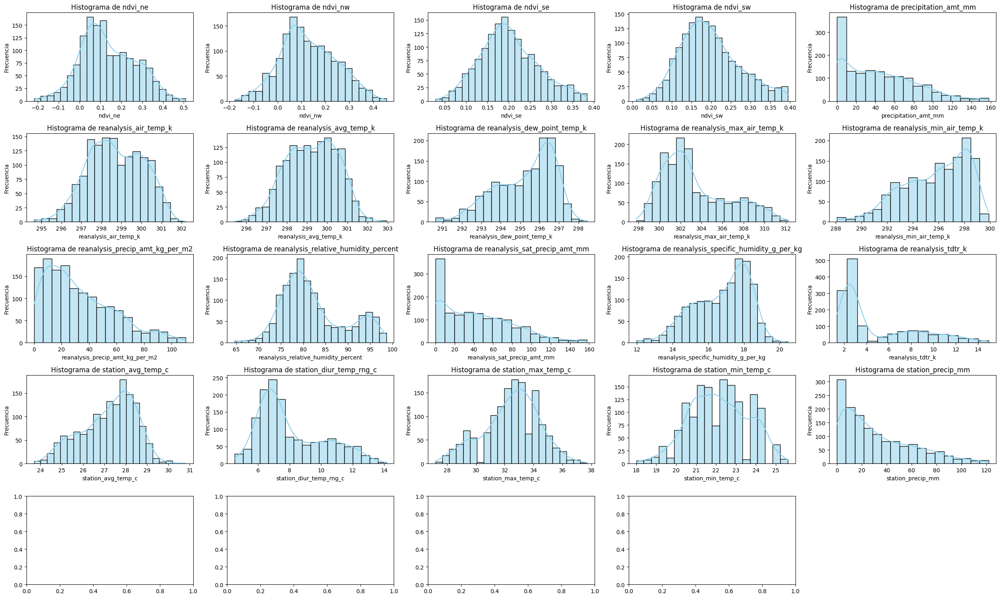

In [68]:
columnas_numericas = train_preproced.select_dtypes(include=[np.number]).columns
num_columnas = len(columnas_numericas)

# Excluir columnas que no son relevantes para la evolución temporal
columnas_a_graficar = [col for col in columnas_numericas if col not in ['year', 'weekofyear', "day", "month"]]

# Calcular el número de filas y columnas para la cuadrícula de subgráficos
num_filas = int(np.ceil(np.sqrt(num_columnas)))
num_columnas_por_fila = int(np.ceil(num_columnas / num_filas))

# Crear la figura y los subgráficos
fig, axes = plt.subplots(num_filas, num_columnas_por_fila, figsize=(5 * num_columnas_por_fila, 3 * num_filas))
axes = axes.flatten() # Para facilitar la iteración

# Iterar sobre las columnas numéricas y graficar los histogramas
for i, col in enumerate(columnas_a_graficar):
    sns.histplot(train_preproced[col], kde=True, color='skyblue', ax=axes[i])
    axes[i].set_title(f'Histograma de {col}')
    axes[i].set_xlabel(col)
    axes[i].set_ylabel('Frecuencia')

# Eliminar subgráficos vacíos si el número de columnas no llena la cuadrícula
if num_columnas < len(axes):
    for j in range(num_columnas, len(axes)):
        fig.delaxes(axes[j])

plt.tight_layout()
plt.show()

### 2.2.2. Análisis bivariante (diagramas de dispersión 2 a 2)

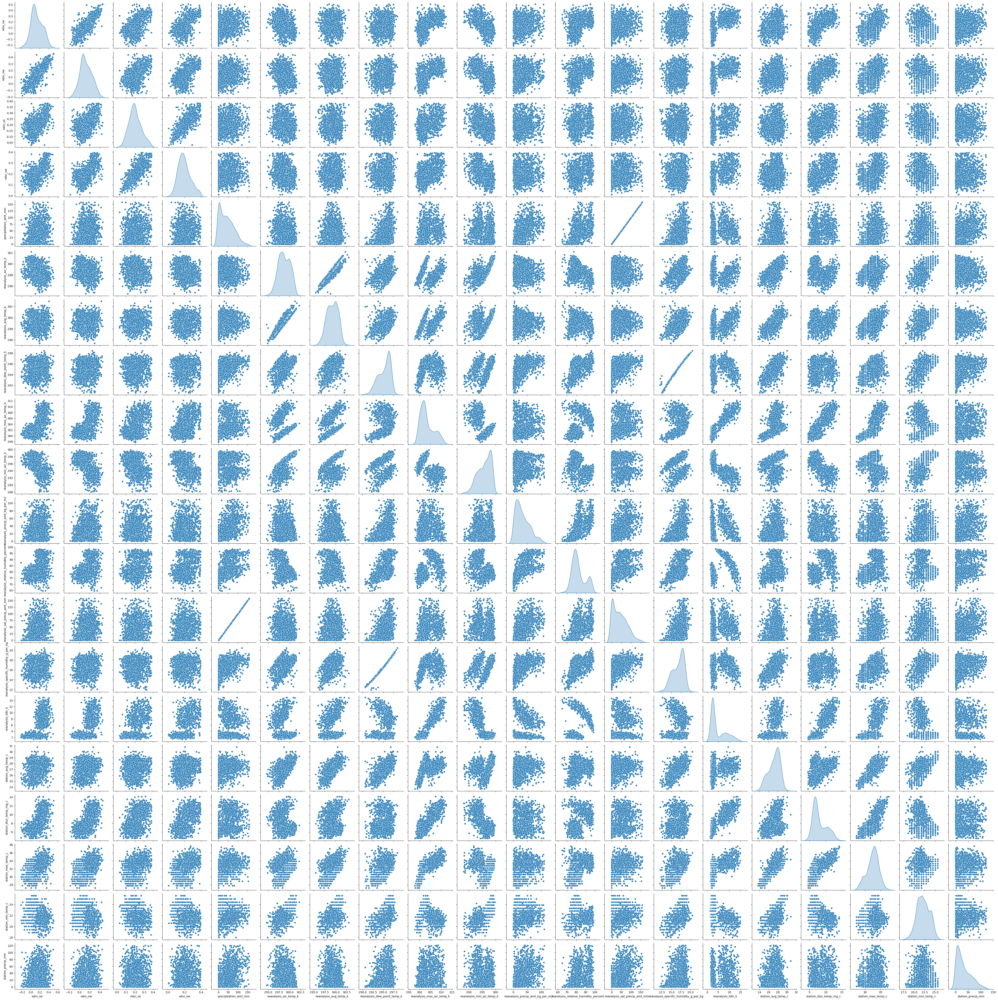

In [69]:
# Scatterplot bivariante
columnas_numericas = train_preproced.select_dtypes(include=[np.number]).columns

# Excluir columnas que no son relevantes para la evolución temporal
columnas_a_graficar = [col for col in columnas_numericas if col not in ['year', 'weekofyear', "day", "month"]]

sns.pairplot(train_preproced[columnas_a_graficar], diag_kind = 'kde')
plt.show()

Debido a la cantidad grande de variables podemos agrupar las variables para el análisis bivariante considerando su origen y el tipo de información que proporcionan.

- Grupo 1: Temperatura - Medidas desde Estación vs. Reanálisis

    - station_max_temp_c

    - station_min_temp_c

    - station_avg_temp_c

    - reanalysis_max_air_temp_k

    - reanalysis_min_air_temp_k

    - reanalysis_avg_temp_k

Agrupamos las mediciones de temperatura tomadas directamente en las estaciones meteorológicas con las estimaciones de temperatura provenientes del reanálisis. Esto nos permitirá observar si existe una correlación fuerte entre estas diferentes fuentes de datos y si hay diferencias sistemáticas en las mediciones. Entender la relación entre las temperaturas medidas a nivel local y las estimaciones a mayor escala puede ser valioso.

<Figure size 600x600 with 0 Axes>

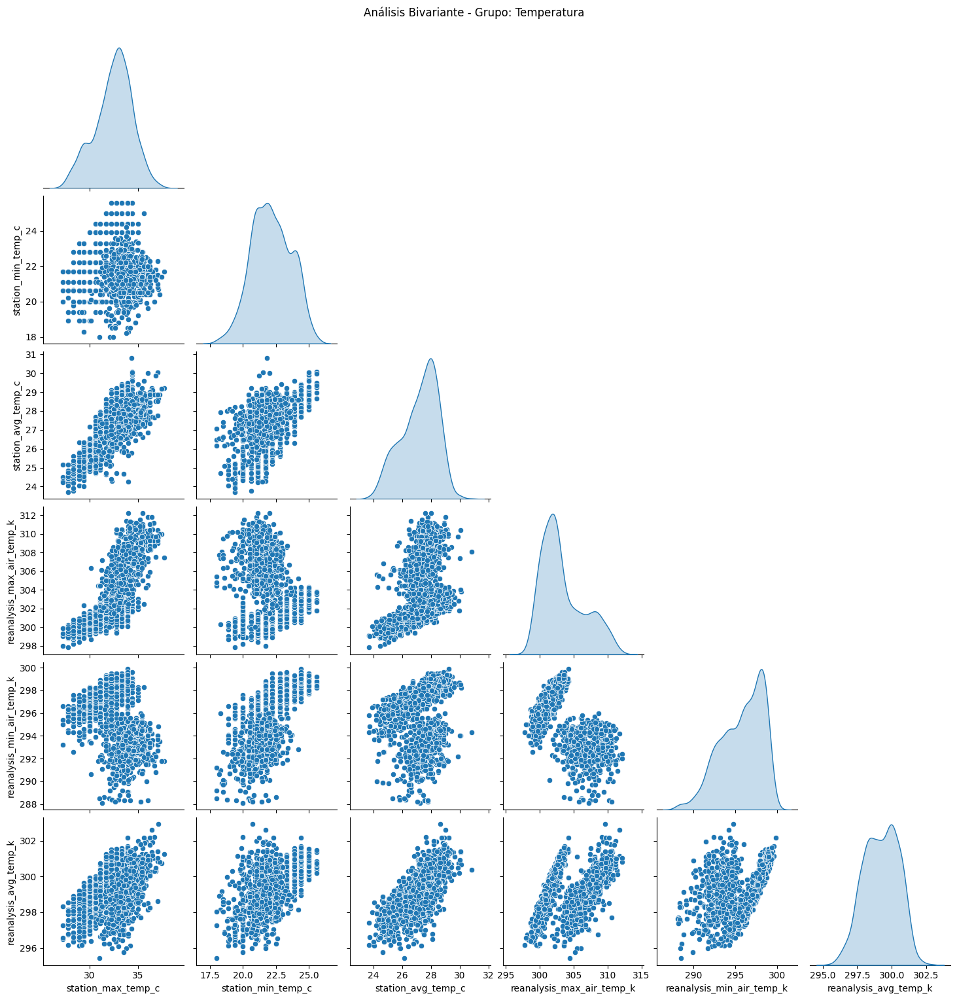

In [70]:
nombre_grupo = "Temperatura"

columnas = ['station_max_temp_c', 'station_min_temp_c', 'station_avg_temp_c',
        'reanalysis_max_air_temp_k', 'reanalysis_min_air_temp_k', 'reanalysis_avg_temp_k']


plt.figure(figsize=(6, 6))
sns.pairplot(train_preproced[columnas], diag_kind='kde', corner=True)
plt.suptitle(f'Análisis Bivariante - Grupo: {nombre_grupo}', y=1.02)
plt.show()

- Grupo 2: Precipitación - Diferentes Fuentes de Medición

    - precipitation_amt_mm (Satélite)

    - reanalysis_sat_precip_amt_mm (Reanálisis)

    - reanalysis_precip_amt_kg_per_m2 (Reanálisis - otra unidad)

    - station_precip_mm (Estación)

Este grupo reúne las mediciones de precipitación de diferentes fuentes (satélite, reanálisis y estaciones). Es crucial analizar cómo se correlacionan estas diferentes medidas de precipitación, ya que pueden tener diferentes niveles de precisión y capturar fenómenos ligeramente distintos. Visualizar estas relaciones puede ayudar a entender la consistencia de los datos de precipitación.

<Figure size 600x600 with 0 Axes>

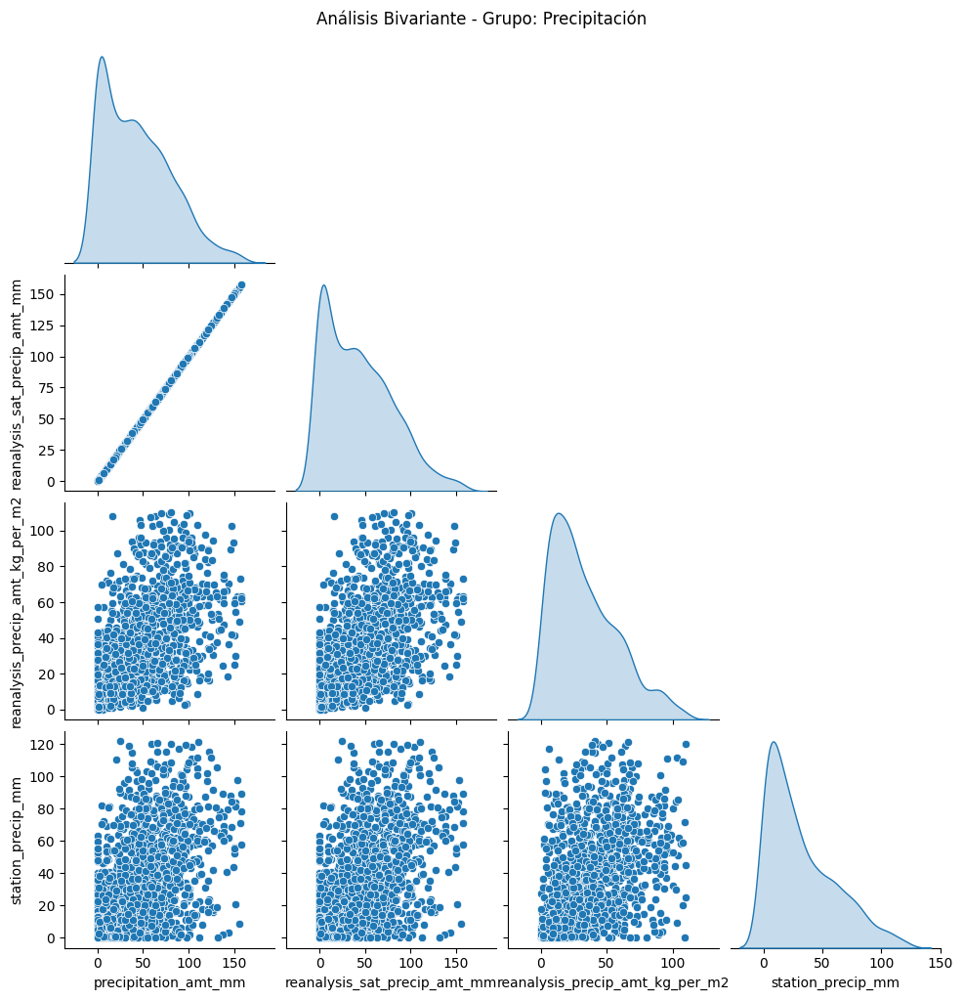

In [71]:
nombre_grupo = "Precipitación"

columnas = ['precipitation_amt_mm', 'reanalysis_sat_precip_amt_mm',
        'reanalysis_precip_amt_kg_per_m2', 'station_precip_mm']

plt.figure(figsize=(6, 6))
sns.pairplot(train_preproced[columnas], diag_kind='kde', corner=True)
plt.suptitle(f'Análisis Bivariante - Grupo: {nombre_grupo}', y=1.02)
plt.show()

- Grupo 3: Humedad - Diversas Medidas

    - reanalysis_dew_point_temp_k

    - reanalysis_relative_humidity_percent

    - reanalysis_specific_humidity_g_per_kg

Agrupamos diferentes medidas relacionadas con la humedad atmosférica. La temperatura del punto de rocío, la humedad relativa y la humedad específica ofrecen perspectivas distintas sobre la cantidad de vapor de agua en el aire. Analizar las relaciones entre estas variables puede proporcionar una comprensión más completa de las condiciones de humedad.

<Figure size 600x600 with 0 Axes>

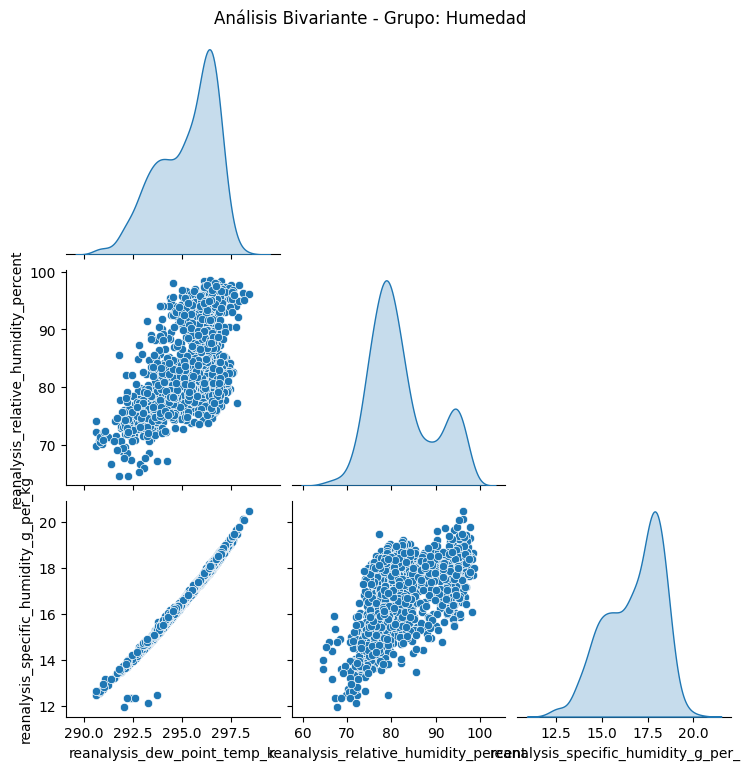

In [72]:
nombre_grupo = "Humedad"

columnas = ['reanalysis_dew_point_temp_k', 'reanalysis_relative_humidity_percent',
        'reanalysis_specific_humidity_g_per_kg']

plt.figure(figsize=(6, 6))
sns.pairplot(train_preproced[columnas], diag_kind='kde', corner=True)
plt.suptitle(f'Análisis Bivariante - Grupo: {nombre_grupo}', y=1.02)
plt.show()

- Grupo 4: Rangos de Temperatura - Variabilidad Diurna

    - station_diur_temp_rng_c

    - reanalysis_tdtr_k

Este grupo se centra en la variabilidad de la temperatura a lo largo del día, medida tanto por las estaciones meteorológicas como por el reanálisis. Comparar estos rangos puede revelar si las mediciones locales y las estimaciones globales concuerdan en cuanto a la amplitud de las fluctuaciones de temperatura diarias.

<Figure size 600x600 with 0 Axes>

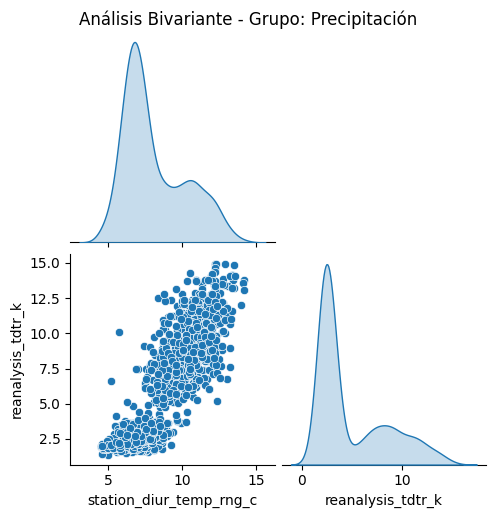

In [73]:
nombre_grupo = "Precipitación"

columnas = ['station_diur_temp_rng_c', 'reanalysis_tdtr_k']

plt.figure(figsize=(6, 6))
sns.pairplot(train_preproced[columnas], diag_kind='kde', corner=True)
plt.suptitle(f'Análisis Bivariante - Grupo: {nombre_grupo}', y=1.02)
plt.show()

- Grupo 5: Índices de Vegetación (NDVI)

    - ndvi_ne

    - ndvi_nw

    - ndvi_se

    - ndvi_sw

Agrupamos los diferentes píxeles del índice de vegetación NDVI alrededor del centroide de la ciudad. Analizar las correlaciones entre estos índices puede ayudar a entender si la vegetación en diferentes direcciones alrededor de la ciudad presenta patrones similares y cómo varía la cobertura vegetal.

<Figure size 600x600 with 0 Axes>

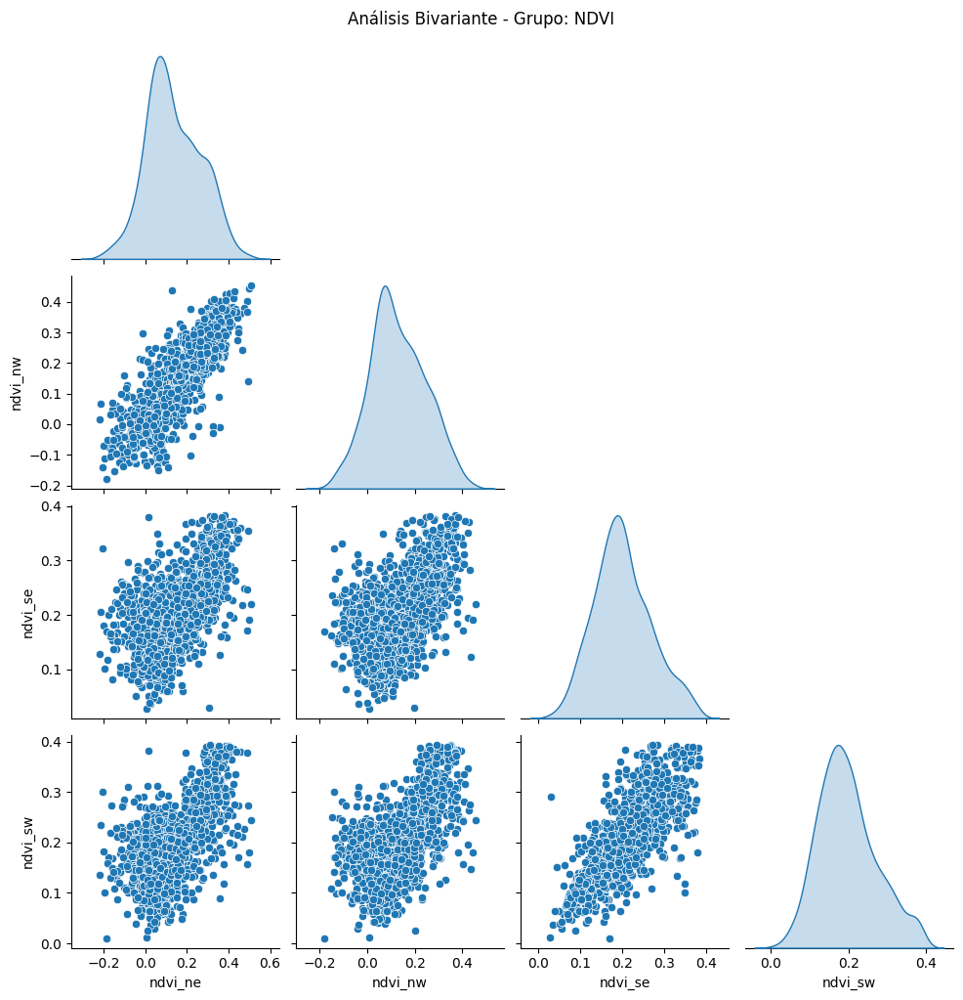

In [74]:
nombre_grupo = "NDVI"

columnas = ['ndvi_ne', 'ndvi_nw', 'ndvi_se', 'ndvi_sw']

plt.figure(figsize=(6, 6))
sns.pairplot(train_preproced[columnas], diag_kind='kde', corner=True)
plt.suptitle(f'Análisis Bivariante - Grupo: {nombre_grupo}', y=1.02)
plt.show()

### 2.2.3. Gráficas de evolución temporal

In [75]:
train_preproced['city'].unique()

array(['sj', 'iq'], dtype=object)

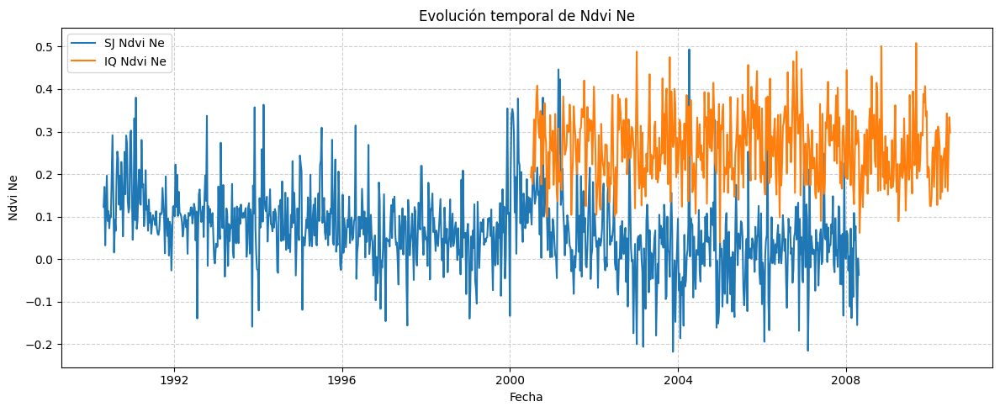

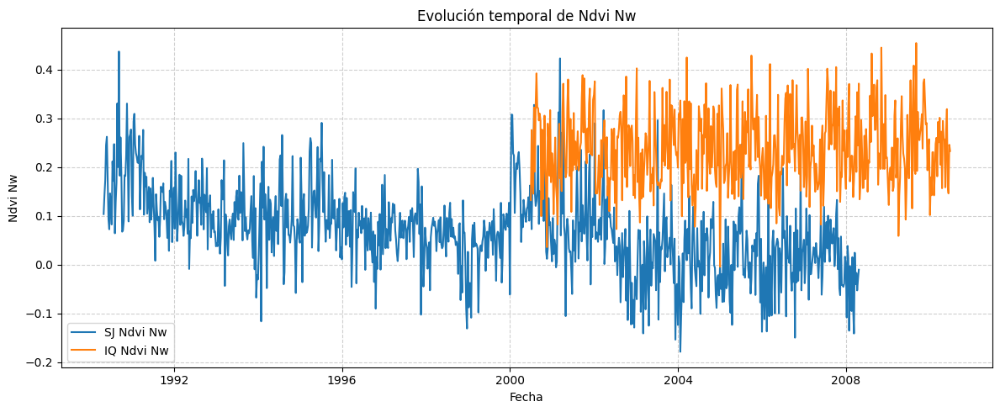

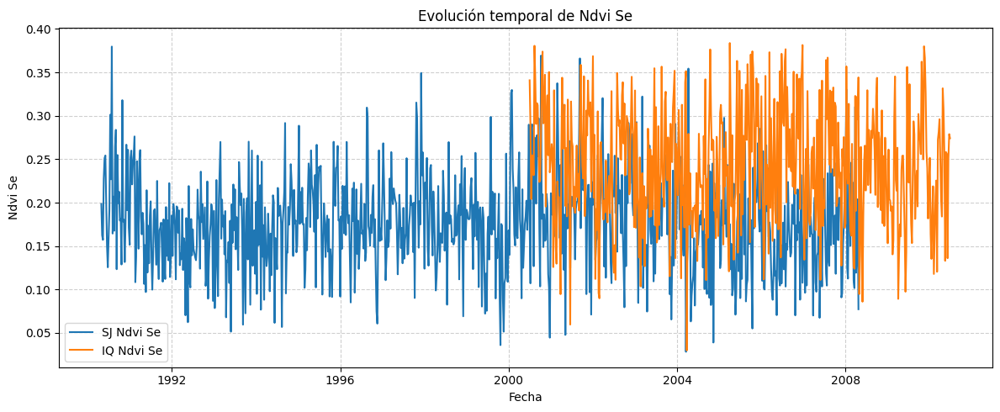

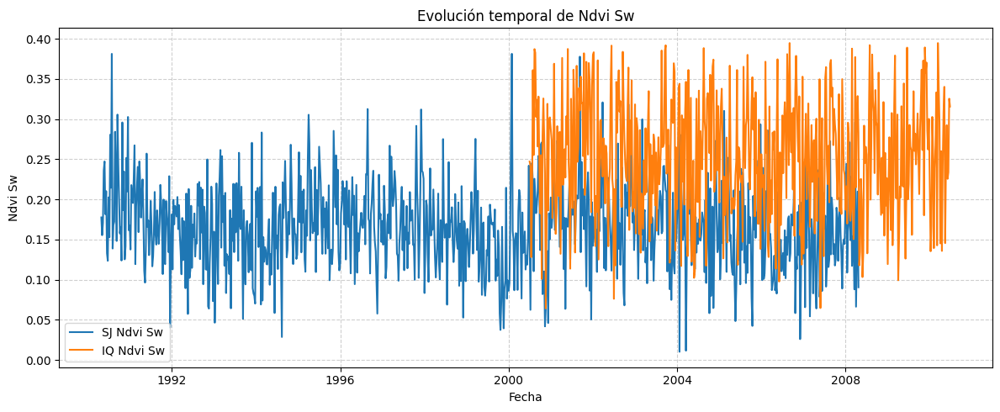

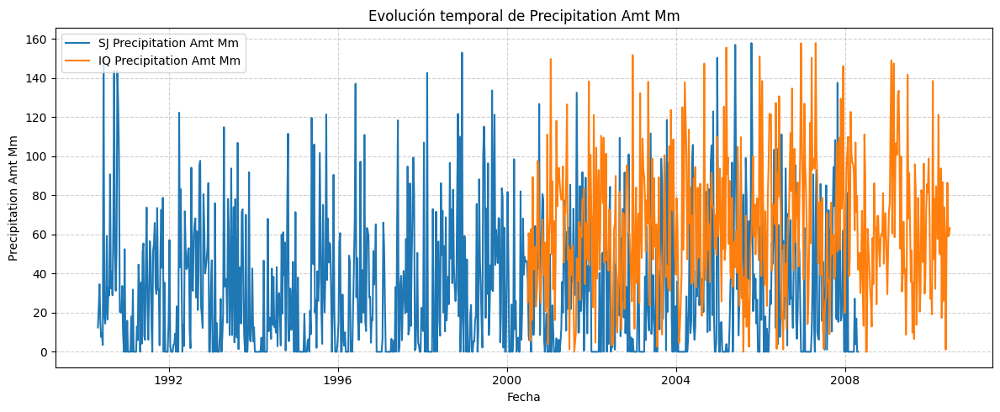

...

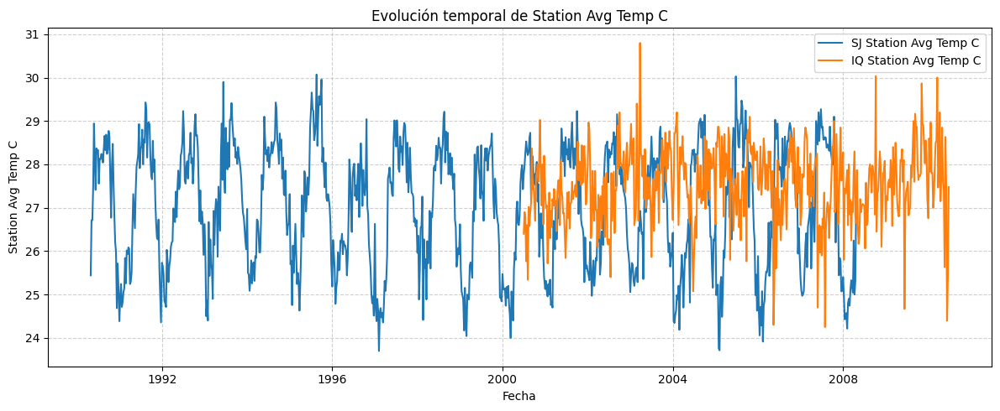

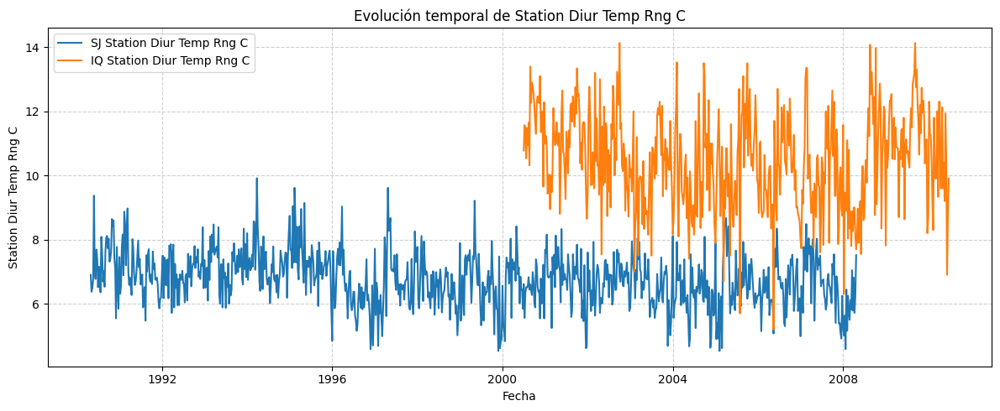

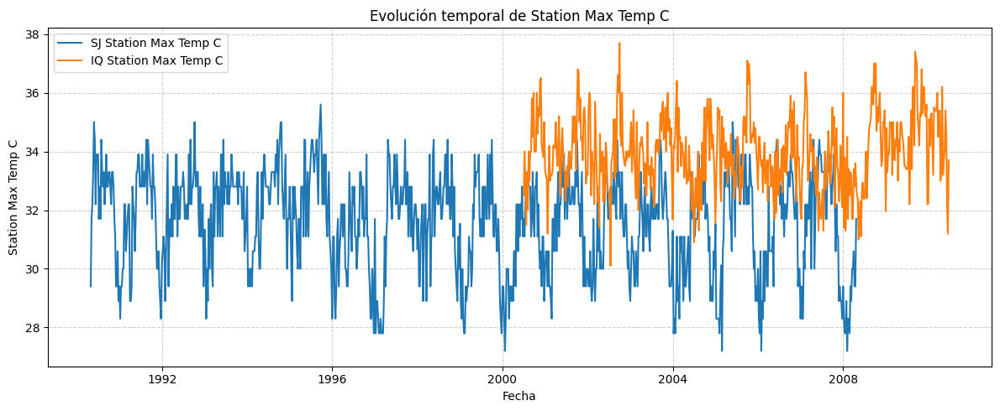

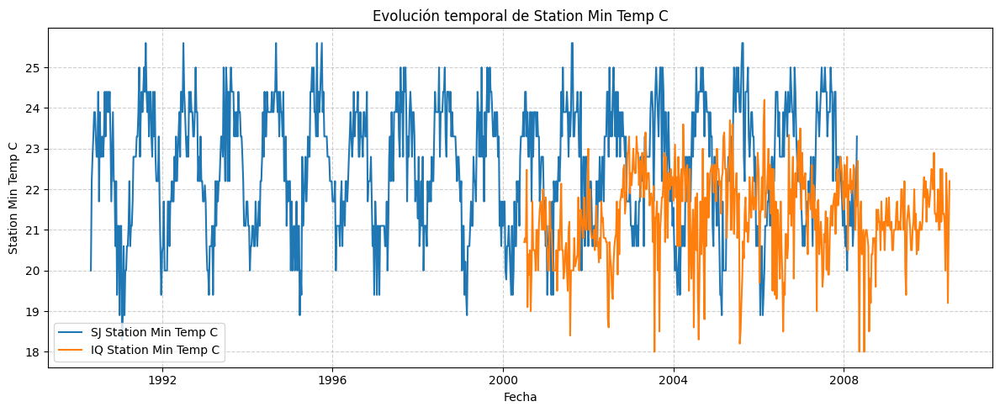

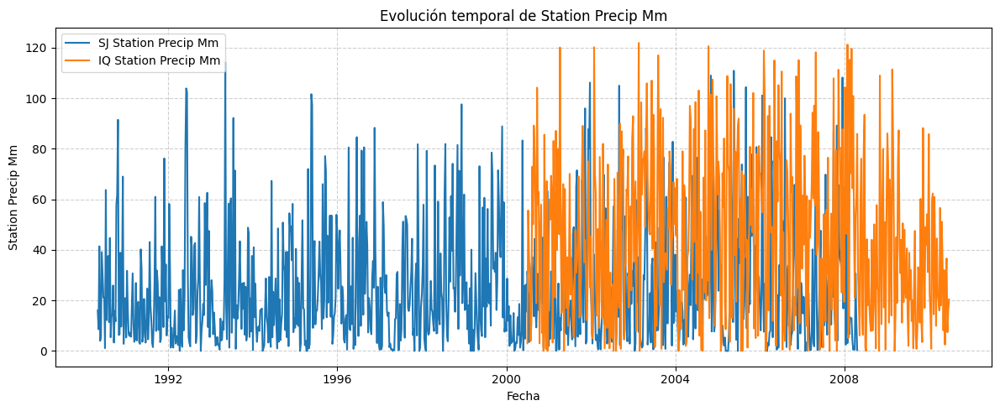

In [76]:
# Convertir 'week_start_date' a datetime
train_preproced['date'] = pd.to_datetime(train_preproced[['year', 'month', 'day']])

columnas_numericas = train_preproced.select_dtypes(include=[np.number]).columns

# Excluir columnas que no son relevantes para la evolución temporal
columnas_a_graficar = [col for col in columnas_numericas if col not in ['year', 'weekofyear', "day", "month"]]

ciudades = train_preproced['city'].unique()

for col in columnas_a_graficar:
    plt.figure(figsize=(12, 5))
    for ciudad in ciudades:
        df_ciudad = train_preproced[train_preproced['city'] == ciudad].copy()
        plt.plot(df_ciudad['date'], df_ciudad[col], label=f'{ciudad.upper()} {col.replace("_", " ").title()}')

    plt.title(f'Evolución temporal de {col.replace("_", " ").title()}')
    plt.xlabel('Fecha')
    plt.ylabel(col.replace("_", " ").title())
    plt.legend()
    plt.grid(True, linestyle='--', alpha=0.6) # Añadir una cuadrícula sutil para facilitar la lectura
    plt.tight_layout() # Ajustar el diseño para evitar el recorte de etiquetas
    plt.show()

train_preproced.drop(columns=['date'], inplace=True)

### 2.2.4. Correlaciones

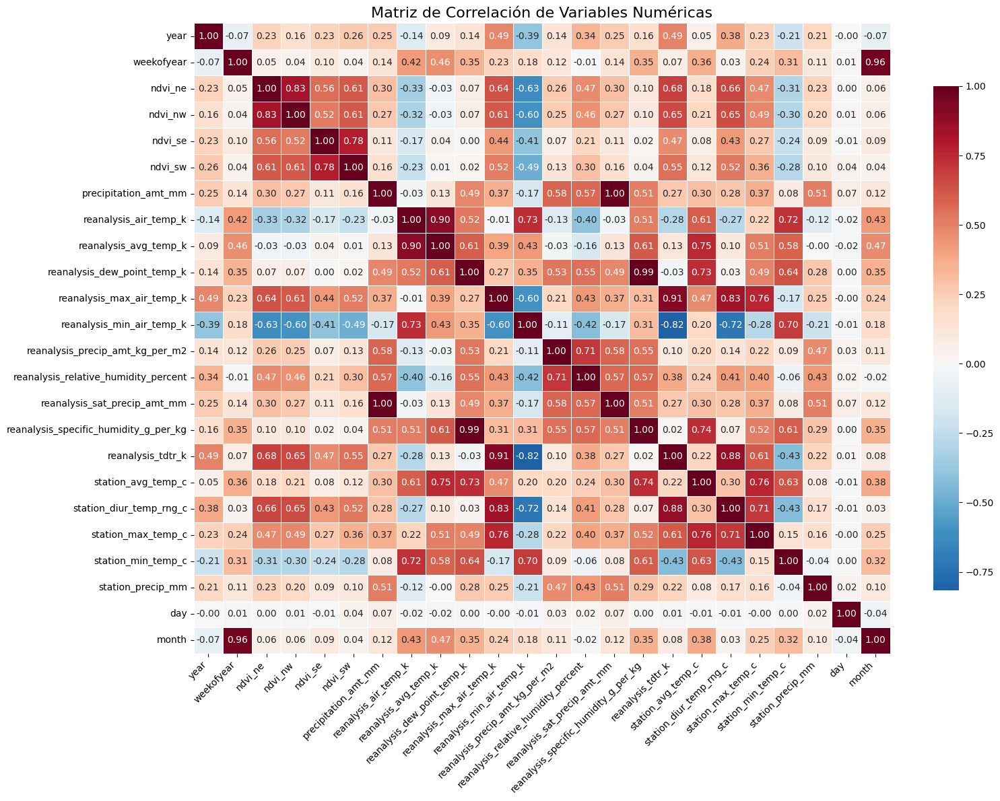

In [77]:
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np

# Extraemos las correlaciones del dataframe
corr_matrix = train_preproced.select_dtypes(include=[np.number]).corr()

# Creamos la figua
plt.figure(figsize=(16, 12)) 

sns.heatmap(corr_matrix, 
            annot=True,   
            fmt=".2f",      
            cmap='RdBu_r',  
            center=0,  
            linewidths=.5,
            cbar_kws={"shrink": .8})

plt.title('Matriz de Correlación de Variables Numéricas', fontsize=16)
plt.xticks(fontsize=10, rotation=45, ha='right')
plt.yticks(fontsize=10)
plt.tight_layout()
plt.show()

---
# Características
---

## 4.1 Creación de nuevas características

Tras analizar la matriz de correlaciones, observamos varios puntos relevantes:

1) Los valores de NDVI (ndvi_ne, ndvi_nw, ndvi_se, ndvi_sw) presentan
   correlaciones altas entre sí (por ejemplo ndvi_ne <-> ndvi_nw ~ 0.8273).
   -> Para evitar manejarlos como 4 variables muy redundantes, 
      creamos un 'promedio de NDVI' (calc_ndvi_avg) y 'rango de NDVI' 
      (calc_ndvi_range), que capturan la salud vegetal media y la variabilidad 
      dentro de esos píxeles.

2) Las variables de temperaturas (reanalysis_max_air_temp_k, reanalysis_min_air_temp_k,
   station_max_temp_c, station_min_temp_c, etc.) están fuertemente correlacionadas,
   pues miden fenómenos similares desde distintas fuentes. Por ejemplo,
   'reanalysis_max_air_temp_k' y 'station_max_temp_c' correlacionan positivamente,
   'reanalysis_tdtr_k' (rango temp. reanalysis) ~ 0.91 con reanalysis_max_air_temp_k.
   -> Para capturar la variabilidad de la temperatura, creamos:
      - calc_temp_range_c: rango de temperatura en °C a partir de la estación (max - min).
      - calc_temp_range_k: rango de temperatura en K a partir de reanalysis (max - min).
      - calc_total_avg_air_temp: promedio entre reanalysis_air_temp_k (convertido a °C) 
        y station_avg_temp_c, para unificar ambas fuentes en una sola métrica.
      - calc_avg_temp_range_c: si queremos mezclar la información de range en K y range en C
        (aunque luego podría presentar alta correlación con reanalysis_tdtr_k).

3) La precipitación medida en estación (station_precip_mm) y la de reanalysis (reanalysis_precip_amt_kg_per_m2)
   tienen una correlación moderada (~ 0.47), pero ambas recogen información relevante
   sobre la lluvia. Un valor de 1 kg/m^2 de agua corresponde aproximadamente a 1 mm de precipitación.
   -> Creamos calc_avg_precip como la media de ambas variables para sintetizar en 
      un indicador combinado.

Estas variables nuevas pueden aportar información útil al agrupar (clustering) o reducir la dimensionalidad. Posteriormente, revisamos de nuevo la matriz de correlación para eliminar variables redundantes (si hay correlación > 0.95, por ejemplo)

In [78]:
# 1. Promedio y Rango de NDVI
train_preproced['calc_ndvi_avg'] = train_preproced[['ndvi_ne','ndvi_nw','ndvi_se','ndvi_sw']].mean(axis=1)
train_preproced['calc_ndvi_range'] = (train_preproced[['ndvi_ne','ndvi_nw','ndvi_se','ndvi_sw']].max(axis=1) 
                            - train_preproced[['ndvi_ne','ndvi_nw','ndvi_se','ndvi_sw']].min(axis=1))

# 2. Índices de Temperaturas
train_preproced['calc_temp_range_c'] = train_preproced['station_max_temp_c'] - train_preproced['station_min_temp_c']
train_preproced['calc_total_avg_air_temp'] = ((train_preproced['reanalysis_air_temp_k'] - 273.15) 
                                    + train_preproced['station_avg_temp_c']) / 2
train_preproced['calc_temp_range_k'] = train_preproced['reanalysis_max_air_temp_k'] - train_preproced['reanalysis_min_air_temp_k']
train_preproced['calc_avg_temp_range_c'] = ((train_preproced['calc_temp_range_k'] - 273.15) 
                                    + train_preproced['calc_temp_range_c']) / 2

# 3. Precipitación media (aprox. 1 kg/m^2 ~ 1 mm)
train_preproced['calc_avg_precip'] = train_preproced[['reanalysis_precip_amt_kg_per_m2','station_precip_mm']].mean(axis=1)

### 4.1.1 Nueva matriz de correlaciones

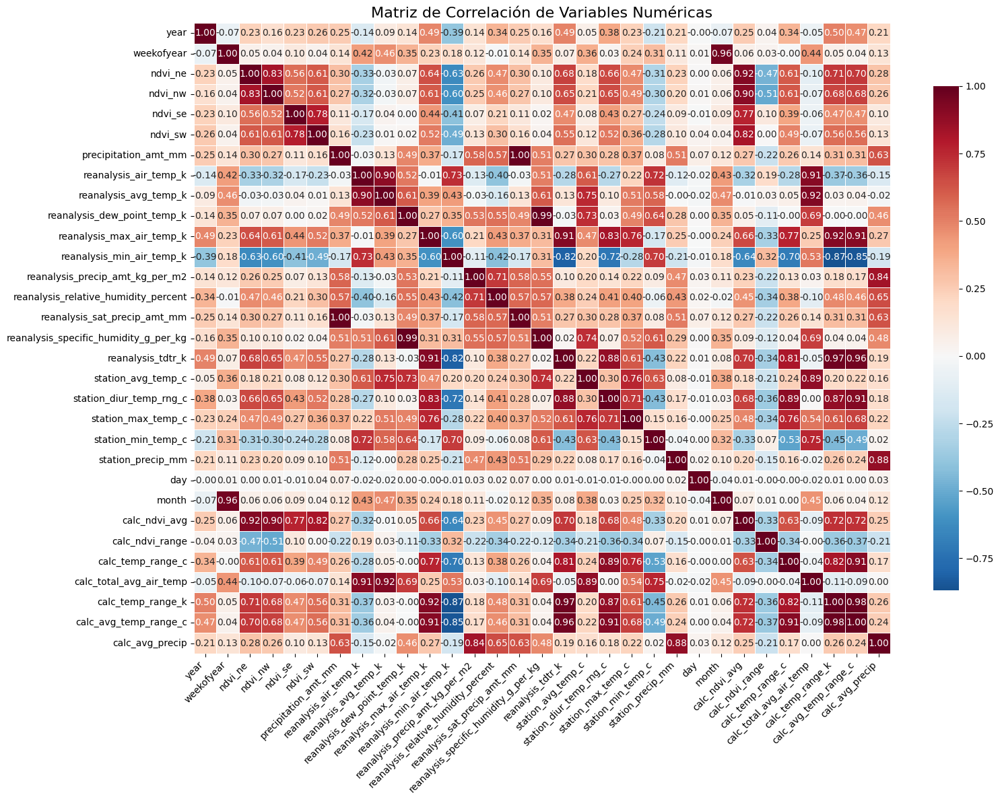

In [79]:
# Extraemos las correlaciones del dataframe
corr_matrix = train_preproced[train_preproced.select_dtypes(include=[np.number]).columns].corr()

# Creamos la figua
plt.figure(figsize=(16, 12)) 

sns.heatmap(corr_matrix, 
            annot=True,   
            fmt=".2f",      
            cmap='RdBu_r',  
            center=0,  
            linewidths=.5,
            cbar_kws={"shrink": .8})

plt.title('Matriz de Correlación de Variables Numéricas', fontsize=16)
plt.xticks(fontsize=10, rotation=45, ha='right')
plt.yticks(fontsize=10)
plt.tight_layout()
plt.show()


Observando la matriz de correlación que muestras, se ve, por ejemplo:
 - calc_temp_range_k con reanalysis_tdtr_k ~ 0.9703
 - calc_avg_temp_range_c con reanalysis_tdtr_k ~ 0.9588
 - calc_temp_range_k y calc_avg_temp_range_c entre sí ~ 0.9834

Estas correlaciones > 0.95 indican fuerte redundancia. 
De acuerdo con el ejemplo anterior, eliminamos 'calc_temp_range_k' y 'calc_avg_temp_range_c'.

In [81]:
vars_eliminar = ['calc_temp_range_k','calc_avg_temp_range_c']
train_preproced.drop(vars_eliminar, axis=1, inplace=True)

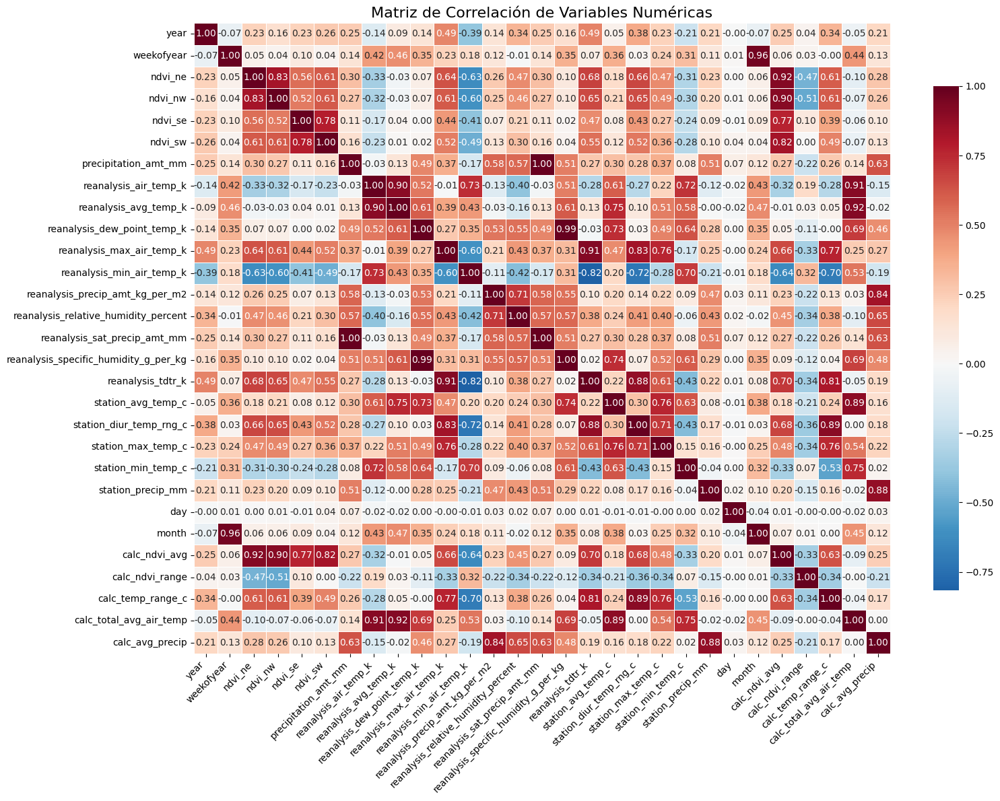

In [82]:
# Extraemos las correlaciones del dataframe
corr_matrix = train_preproced[train_preproced.select_dtypes(include=[np.number]).columns].corr()

# Creamos la figua
plt.figure(figsize=(16, 12)) 

sns.heatmap(corr_matrix, 
            annot=True,   
            fmt=".2f",      
            cmap='RdBu_r',  
            center=0,  
            linewidths=.5,
            cbar_kws={"shrink": .8})

plt.title('Matriz de Correlación de Variables Numéricas', fontsize=16)
plt.xticks(fontsize=10, rotation=45, ha='right')
plt.yticks(fontsize=10)
plt.tight_layout()
plt.show()


## 4.2. RELACIÓN JERÁRQUICA DE CARACTERÍSTICAS (DATASET TRANSPUESTO)

In [86]:
# Binarizamos la ciudad
lb = preprocessing.LabelBinarizer()
train_preproced['city'] = lb.fit_transform(train_preproced['city'])

In [103]:
# Volvemos a tomar las columnas numéricas tras posibles eliminaciones
all_numeric_cols = train_preproced.select_dtypes(include=[np.number]).columns

# Transponemos: ahora cada FILA es una CARACTERÍSTICA, y las COLUMNAS son los EJEMPLOS
train_transposed = train_preproced[all_numeric_cols].T

In [104]:
train_transposed.head()

,0,1,2,3,4,5,6,7,8,9,...,1446,1447,1448,1449,1450,1451,1452,1453,1454,1455
city,1.000000,1.000000,1.000000,1.000000,1.0000,1.000000,1.0000,1.0000,1.000000,1.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000
year,1990.000000,1990.000000,1990.000000,1990.000000,1990.0000,1990.000000,1990.0000,1990.0000,1990.000000,1990.000000,...,2010.000000,2010.000000,2010.000000,2010.000000,2010.000000,2010.00000,2010.000000,2010.000000,2010.000000,2010.000000
weekofyear,18.000000,19.000000,20.000000,21.000000,22.0000,23.000000,24.0000,25.0000,26.000000,27.000000,...,16.000000,17.000000,18.000000,19.000000,20.000000,21.00000,22.000000,23.000000,24.000000,25.000000
ndvi_ne,0.122600,0.169900,0.032250,0.128633,0.1962,0.089657,0.1129,0.0725,0.102450,0.098357,...,0.231486,0.239743,0.260814,0.168686,0.263071,0.34275,0.160157,0.247057,0.333914,0.298186
ndvi_nw,0.103725,0.142175,0.172967,0.245067,0.2622,0.174850,0.0928,0.0725,0.146175,0.121550,...,0.294686,0.259271,0.255786,0.158500,0.272500,0.31890,0.160371,0.146057,0.245771,0.232971


## 4.3 DENDROGRAMAS (AGRUPACIÓN JERÁRQUICA DE CARACTERÍSTICAS)

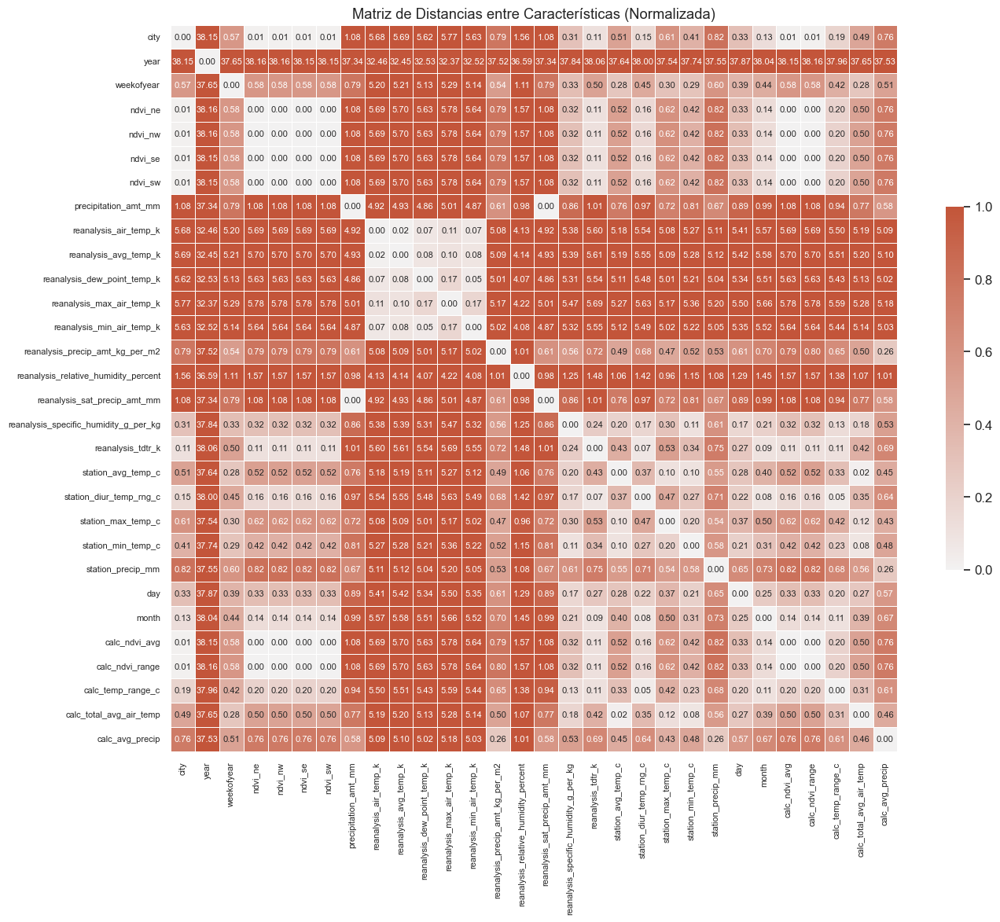

In [112]:
import matplotlib.pyplot as plt
import seaborn as sns
from scipy.cluster import hierarchy
from sklearn.metrics import DistanceMetric
from sklearn.preprocessing import MinMaxScaler

# Normalizamos la matriz transpuesta (características x ejemplos) 
# para que todas las distancias estén en [0,1] (o similar)
scaler = MinMaxScaler()
transposed_array = scaler.fit_transform(train_transposed.values)

# Cálculo de distancias euclídeas entre características (filas de transposed_array)
dist = DistanceMetric.get_metric('euclidean')
matdist = dist.pairwise(transposed_array)

# Heatmap de la matriz de distancias
f, ax = plt.subplots(figsize=(16, 12))
cmap = sns.diverging_palette(230, 20, as_cmap=True)
sns.heatmap(
    matdist, 
    cmap=cmap, 
    vmax=1, 
    vmin=0, 
    center=0,
    xticklabels=train_transposed.index, 
    yticklabels=train_transposed.index,
    square=True, 
    linewidths=.5, 
    cbar_kws={"shrink": .5},
    annot=True, 
    fmt=".2f", 
    annot_kws={"size": 8})
plt.xticks(fontsize=8, rotation=90)
plt.yticks(fontsize=8, rotation=0)
plt.title("Matriz de Distancias entre Características (Normalizada)")
plt.show()

C:\Users\ALEX\AppData\Local\Temp\ipykernel_17748\759267312.py:16: ClusterWarning: The symmetric non-negative hollow observation matrix looks suspiciously like an uncondensed distance matrix
  clusters = hierarchy.linkage(matdist, method='average')


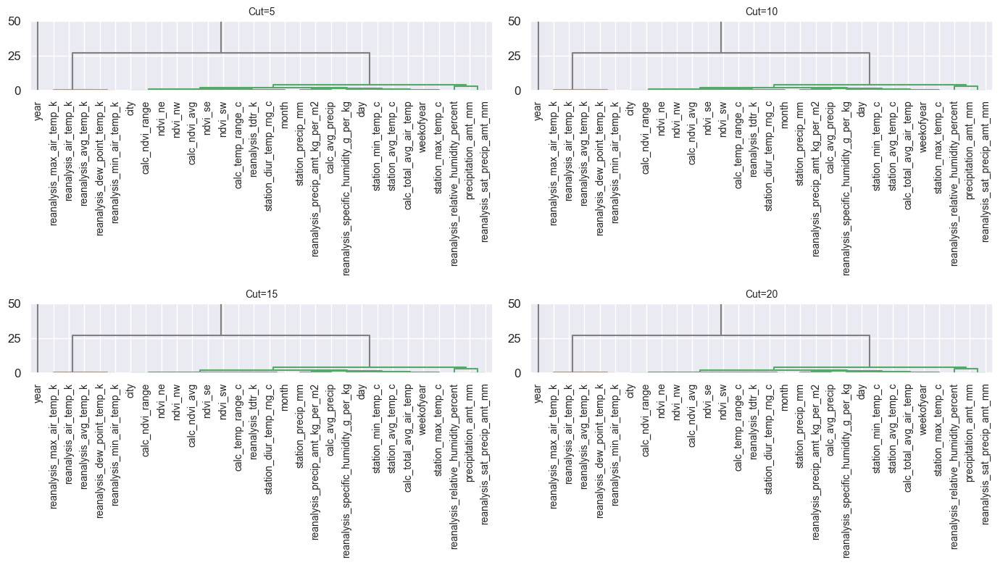

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from scipy.cluster import hierarchy
from scipy import cluster

# Ajustar figura y fuente
sns.set(font_scale=1.1)
k = 2  # para subplots de 2x2
fig, axs = plt.subplots(k, k, figsize=(14, 8))

# Aplicar un método de linkage 'average'
clusters = hierarchy.linkage(matdist, method='average')

# Diferentes color_threshold
cortes = [5, 10, 15, 20]

for idx, cut in enumerate(cortes):
    i, j = divmod(idx, k)  # para ubicarnos en axs[i,j]
    
    # Graficamos dendrograma en la subfigura axs[i,j]
    dend = hierarchy.dendrogram(
        clusters,
        color_threshold=cut,
        labels=train_transposed.index,
        leaf_rotation=90, 
        above_threshold_color='grey',
        ax=axs[i, j]
    )
    
    # Ajustamos el título
    axs[i, j].set_title(f"Cut={cut}", fontsize=10)
    
    # Recortamos el eje Y para ocultar distancias > 50
    axs[i, j].set_ylim(0, 50)

plt.tight_layout()
plt.show()

## 4.5 PCA DE LAS VARIABLES (2D)

C:\Users\ALEX\AppData\Local\Temp\ipykernel_17748\680526226.py:11: ClusterWarning: The symmetric non-negative hollow observation matrix looks suspiciously like an uncondensed distance matrix
  Z = hierarchy.linkage(matdist, method='average')


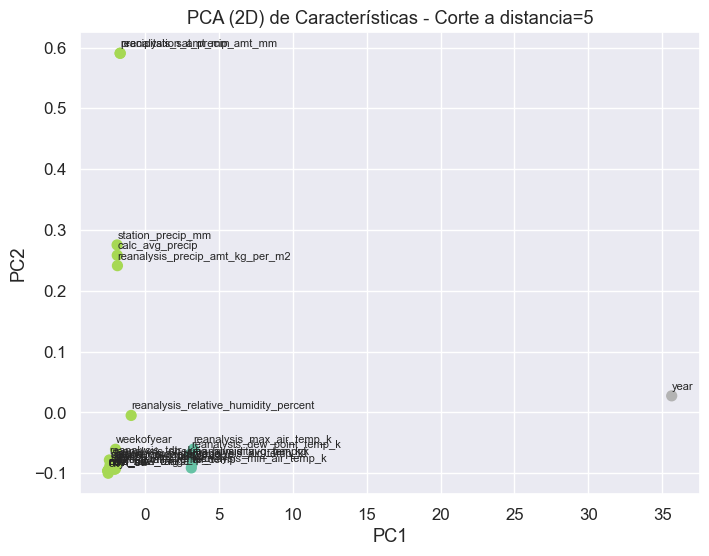

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from scipy.cluster import hierarchy
from scipy.cluster.hierarchy import fcluster
from sklearn.decomposition import PCA
from sklearn.metrics import DistanceMetric
from sklearn.preprocessing import MinMaxScaler

# Realizamos el linkage con 'average' (o el que prefieras)
Z = hierarchy.linkage(matdist, method='average')

# Elegimos un corte en la distancia = 5 para formar clusters
cut_dist = 5
labels_cut = fcluster(Z, t=cut_dist, criterion='distance')
# 'labels_cut' indica el número de clúster al que pertenece cada FILA de matdist

# PCA (2D) de las características
pca = PCA(n_components=2, random_state=42)
X_pca = pca.fit_transform(transposed_array)

# Visualización en 2D con colores según el clúster
plt.figure(figsize=(8,6))
scatter = plt.scatter(
    X_pca[:,0], 
    X_pca[:,1], 
    c=labels_cut,               # color por clúster
    cmap='Set2',                # paleta de colores (puedes cambiar)
    s=50
)

# Añadimos etiquetas de cada variable
feature_names = train_transposed.index  # nombres de las características
for i, feat_name in enumerate(feature_names):
    plt.text(
        X_pca[i,0] + 0.01,      # pequeño desplazamiento para no superponer
        X_pca[i,1] + 0.01,
        feat_name, 
        fontsize=8
    )

plt.title(f"PCA (2D) de Características - Corte a distancia={cut_dist}")
plt.xlabel("PC1")
plt.ylabel("PC2")
plt.grid(True)

plt.show()


---
# Clustering
---

In [118]:
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn import metrics
from sklearn.cluster import KMeans, DBSCAN
from sklearn.mixture import GaussianMixture
from sklearn.cluster import AffinityPropagation
from sklearn.decomposition import PCA
from kneed import KneeLocator
from sklearn.preprocessing import MinMaxScaler

## 5.0 Preparación de los datos para clustering

In [120]:
# Selección de columnas numéricas
numeric_cols = train_preproced.select_dtypes(include=[np.number]).columns

# Normalización (MinMaxScaler o StandardScaler)
scaler = MinMaxScaler()
train_norm = scaler.fit_transform(train_preproced[numeric_cols])

# Generar PCA 2D para visualización
pca = PCA(n_components=2, random_state=42)
X_pca = pca.fit_transform(train_norm)

X_pca

array([[ 0.69079678, -0.71839486],
       [ 0.64888312, -0.32346515],
       [ 0.59542758, -0.03630362],
       ...,
       [-0.84938571, -0.57159805],
       [-1.01368454, -0.4733998 ],
       [-1.10034542, -0.10741956]])

In [121]:
# Función de ayuda para plot en 2D
def plot_train_norm_2D(clustering_labels, algorithm_name="Algorithm"):
    """
    Muestra en 2D (PCA) los puntos coloreados según 'clustering_labels'.
    """
    plt.figure(figsize=(6,5))
    plt.scatter(X_pca[:,0], X_pca[:,1], c=clustering_labels, cmap='Set2', s=20)
    plt.title(f"Clustering con {algorithm_name} (PCA 2D)")
    plt.xlabel("PC1")
    plt.ylabel("PC2")
    plt.grid(True)
    plt.show()

## 5.1 K-MEANS

In [122]:
distortions = []
silhouettes = []
K_range = range(2, 12)

for k in K_range:
    km = KMeans(n_clusters=k, init='k-means++', n_init=10, random_state=42)
    labels_km = km.fit_predict(train_norm)
    distortions.append(km.inertia_)  # Distorsión (inertia)
    sil = metrics.silhouette_score(train_norm, labels_km)
    silhouettes.append(sil)

### 5.1.1 Elbow Method (Distorsión)

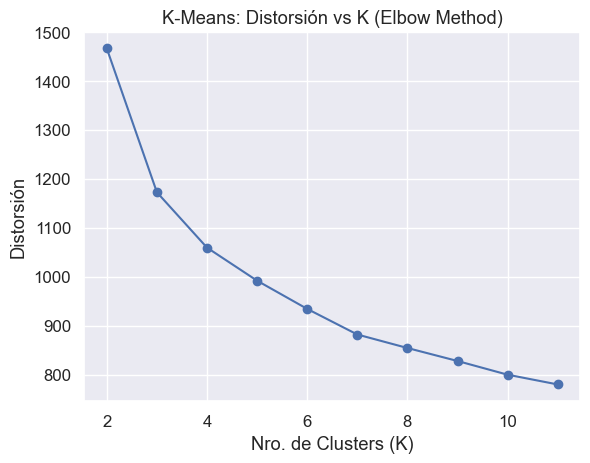

In [123]:
plt.figure()
plt.plot(K_range, distortions, marker='o')
plt.title("K-Means: Distorsión vs K (Elbow Method)")
plt.xlabel("Nro. de Clusters (K)")
plt.ylabel("Distorsión")
plt.grid(True)
plt.show()

In [124]:
# Aplicando KneeLocator
kneedle = KneeLocator(
    K_range,
    distortions,
    curve="convex",
    direction="decreasing"
)
elbow_point = kneedle.elbow
print("Elbow encontrado en K =", elbow_point)

Elbow encontrado en K = 4


### 5.1.2 Silhouette

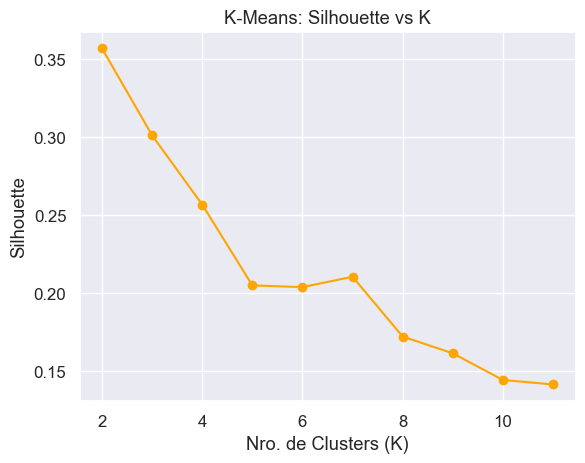

Valores de silhouette: [np.float64(0.357), np.float64(0.301), np.float64(0.257), np.float64(0.205), np.float64(0.204), np.float64(0.211), np.float64(0.172), np.float64(0.161), np.float64(0.144), np.float64(0.142)]


In [125]:
plt.figure()
plt.plot(K_range, silhouettes, marker='o', color='orange')
plt.title("K-Means: Silhouette vs K")
plt.xlabel("Nro. de Clusters (K)")
plt.ylabel("Silhouette")
plt.grid(True)
plt.show()

print("Valores de silhouette:", [round(s,3) for s in silhouettes])

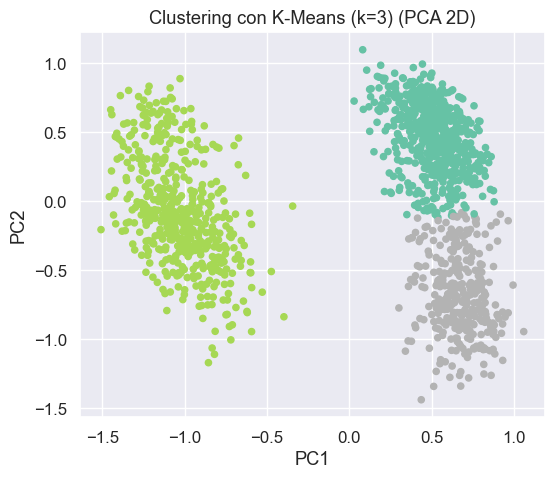

In [127]:
k_final = 3
km_final = KMeans(n_clusters=k_final, init='k-means++', n_init=10, random_state=42)
labels_km_final = km_final.fit_predict(train_norm)
plot_train_norm_2D(labels_km_final, algorithm_name=f"K-Means (k={k_final})")

## 5.2 DBSCAN

In [140]:
# Exploración de 'eps' y 'min_samples'
eps_values = [0.2, 0.4, 0.5, 0.6, 0.8, 1] 
min_samples_values = [5, 10, 15, 20, 25]

best_sil_dbscan = -1
best_params_dbscan = None

for eps in eps_values:
    for ms in min_samples_values:
        dbscan = DBSCAN(eps=eps, min_samples=ms)
        labels_db = dbscan.fit_predict(train_norm)
        # Si hay un único cluster o todo es ruido, la silueta no aplica
        if len(np.unique(labels_db)) < 2:
            sil_db = -1  # ignora
        else:
            sil_db = metrics.silhouette_score(train_norm, labels_db)
        if sil_db > best_sil_dbscan:
            best_sil_dbscan = sil_db
            best_params_dbscan = (eps, ms)

print(f"Mejor Silueta DBSCAN: {best_sil_dbscan:.3f} con eps={best_params_dbscan[0]}, min_samples={best_params_dbscan[1]}")

Mejor Silueta DBSCAN: 0.357 con eps=1, min_samples=5


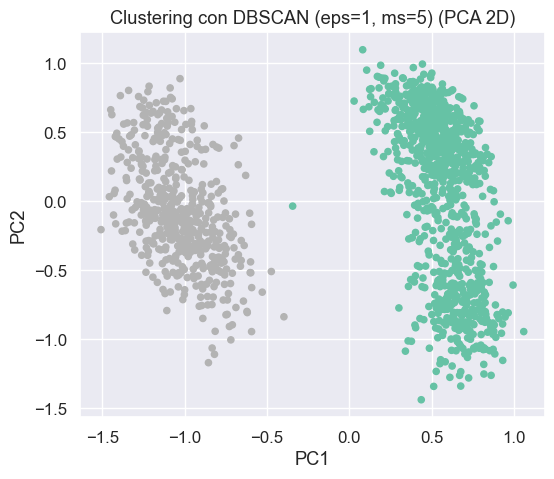

In [141]:
# Visualización
dbscan_best = DBSCAN(eps=best_params_dbscan[0], min_samples=best_params_dbscan[1])
labels_db_best = dbscan_best.fit_predict(train_norm)
plot_train_norm_2D(labels_db_best, algorithm_name=f"DBSCAN (eps={best_params_dbscan[0]}, ms={best_params_dbscan[1]})")

## 5.3 GAUSSIAN MIXTURE (GMM)

In [130]:
K_range_gmm = range(2, 12)  # Ajustar rango
silhouettes_gmm = []
aics = []

for k in K_range_gmm:
    gmm = GaussianMixture(n_components=k, random_state=42)
    gmm_labels = gmm.fit_predict(train_norm)
    sil_gmm = metrics.silhouette_score(train_norm, gmm_labels)
    silhouettes_gmm.append(sil_gmm)
    aics.append(gmm.aic(train_norm))

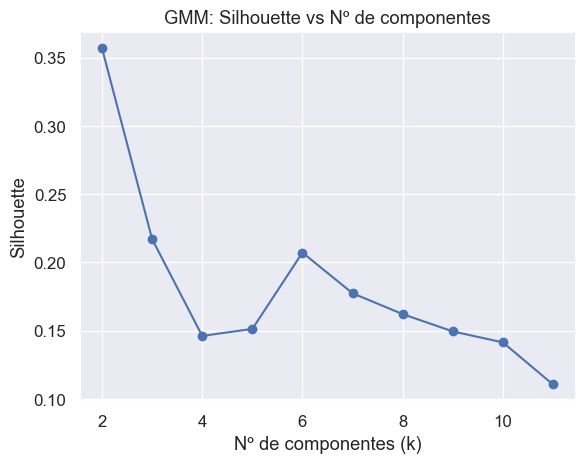

Silhouette GMM: [np.float64(0.357), np.float64(0.217), np.float64(0.146), np.float64(0.151), np.float64(0.207), np.float64(0.177), np.float64(0.162), np.float64(0.15), np.float64(0.141), np.float64(0.111)]
Mejor k (Silhouette) = 2


In [131]:
# -- Silueta vs k
plt.figure()
plt.plot(K_range_gmm, silhouettes_gmm, marker='o')
plt.title("GMM: Silhouette vs Nº de componentes")
plt.xlabel("Nº de componentes (k)")
plt.ylabel("Silhouette")
plt.grid(True)
plt.show()

print("Silhouette GMM:", [round(s,3) for s in silhouettes_gmm])

best_k_sil = K_range_gmm[np.argmax(silhouettes_gmm)]
print("Mejor k (Silhouette) =", best_k_sil)

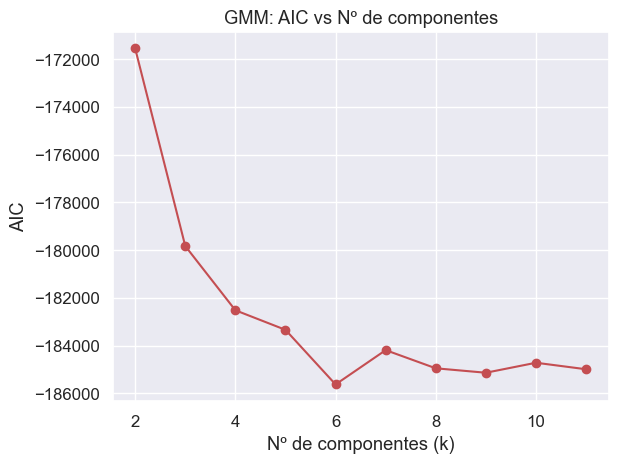

In [133]:
# -- AIC vs k
plt.figure()
plt.plot(K_range_gmm, aics, marker='o', color='r')
plt.title("GMM: AIC vs Nº de componentes")
plt.xlabel("Nº de componentes (k)")
plt.ylabel("AIC")
plt.grid(True)
plt.show()

Mejor k (AIC) = 6


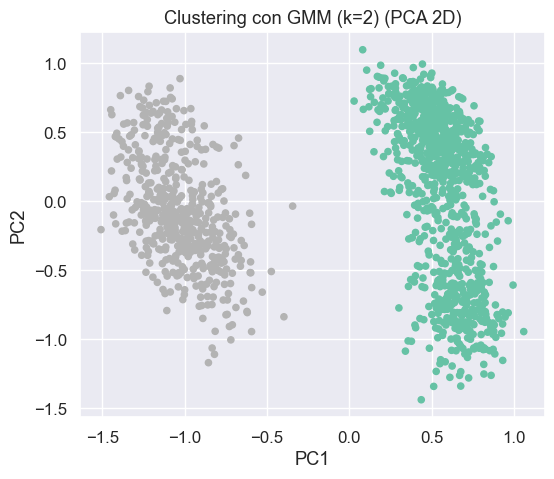

In [134]:
best_k_aic = K_range_gmm[np.argmin(aics)]
print("Mejor k (AIC) =", best_k_aic)

# Visualizamos con el mejor k según Silueta
gmm_final = GaussianMixture(n_components=best_k_sil, random_state=42)
labels_gmm_final = gmm_final.fit_predict(train_norm)
plot_train_norm_2D(labels_gmm_final, algorithm_name=f"GMM (k={best_k_sil})")

C:\Users\ALEX\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\sklearn\cluster\_affinity_propagation.py:140: ConvergenceWarning: Affinity propagation did not converge, this model may return degenerate cluster centers and labels.
  warnings.warn(


AffinityPropagation -> mejor silueta=0.187 con preference=-60


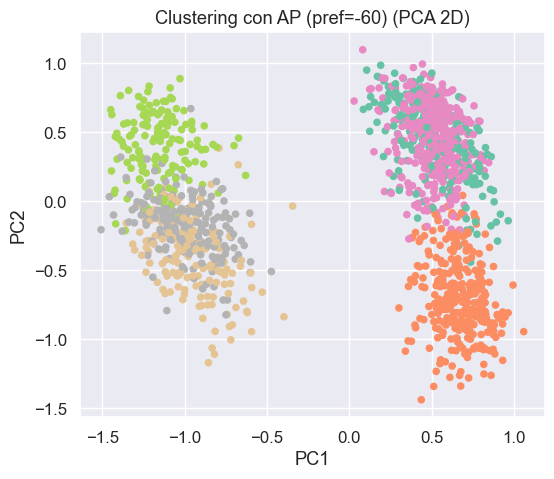

In [142]:
# Param. principal: 'preference'. Más pequeño => menos clusters
pref_values = range(-120, 0, 20)  # Ajustar
best_sil_ap = -1
best_pref = None

for pref in pref_values:
    ap = AffinityPropagation(preference=pref, random_state=42, max_iter=500, convergence_iter=30)
    labels_ap = ap.fit_predict(train_norm)
    if len(np.unique(labels_ap)) < 2 or len(np.unique(labels_ap)) == train_norm.shape[0]:
        sil_ap = -1
    else:
        sil_ap = metrics.silhouette_score(train_norm, labels_ap)
    if sil_ap > best_sil_ap:
        best_sil_ap = sil_ap
        best_pref = pref

print(f"AffinityPropagation -> mejor silueta={best_sil_ap:.3f} con preference={best_pref}")
ap_best = AffinityPropagation(preference=best_pref, random_state=42)
labels_ap_best = ap_best.fit_predict(train_norm)
plot_train_norm_2D(labels_ap_best, algorithm_name=f"AP (pref={best_pref})")

---
# Conclusiones
---

<div style="margin-bottom: 1rem;">
1. <strong>Preprocesado y Limpieza de Datos</strong><br>
Se realizaron cinco experimentos para el manejo de valores nulos y outliers. El <em>Experimento 1</em> (KNNImputer seguido de reimputación de outliers con el mismo método) ofreció un equilibrio aceptable, conservando la mayor cantidad de información y reduciendo en lo posible los valores atípicos sin eliminarlos por completo.  
En contraste, los experimentos con eliminación de datos (Experimento 2 y 5) resultaron demasiado <strong>drásticos</strong>, perdiendo gran cantidad de muestras y potencialmente afectando negativamente el análisis posterior.
</div>

<div style="margin-bottom: 1rem;">
2. <strong>Exploración de Datos</strong><br>
<ul>
  <li><em>Análisis univariante</em>: Variables de precipitación mostraron colas largas y asimetría; otras variables climáticas reflejaron diferentes comportamientos estacionales.</li>
  <li><em>Análisis bivariante</em>: Confirma altas correlaciones entre mediciones afines (ej. temperaturas, precipitaciones), lo que motivó la creación de variables derivadas (promedios, rangos).</li>
  <li><em>Gráficas de evolución temporal</em>: San Juan e Iquitos exhiben dinámicas climáticas distintas. La estacionalidad se hace notoria en temperatura y precipitación.</li>
  <li><em>Matriz de correlación</em>: Se revelaron relaciones muy fuertes entre variables similares, lo cual condujo a la eliminación de columnas redundantes (p.ej., correlación &gt; 0.95).</li>
</ul>
</div>

<div style="margin-bottom: 1rem;">
3. <strong>Ingeniería de Características</strong><br>
Se generaron nuevas variables como:
<ul>
  <li><code>calc_ndvi_avg</code> y <code>calc_ndvi_range</code> (para NDVI)</li>
  <li><code>calc_temp_range_c</code>, <code>calc_temp_range_k</code>, <code>calc_total_avg_air_temp</code>, <code>calc_avg_temp_range_c</code> (para capturar la variabilidad térmica)</li>
  <li><code>calc_avg_precip</code> (indicador promedio de precipitación entre reanalysis y estación)</li>
</ul>
Posteriormente, se eliminaron <code>calc_temp_range_k</code> y <code>calc_avg_temp_range_c</code> por correlaciones excesivamente elevadas (≥0.95).  
La relación jerárquica (dendrogramas) en dataset transpuesto mostró agrupaciones naturales de variables análogas (ej. clima vs. vegetación).
</div>

<div style="margin-bottom: 1rem;">
4. <strong>Clustering</strong><br>
<ul>
  <li><em>K-Means</em>: El método del codo (distorsión) recomienda un <strong>K intermedio</strong>, mientras la Silueta normalmente favorece <strong>K=2</strong>. Esto ocurre porque la Silueta evalúa mayor separación entre grupos.</li>
  <li><em>DBSCAN</em>: Se testearon diferentes <code>eps</code> y <code>min_samples</code>. Se encontró un compromiso entre la separación de clústeres y el número de puntos marcados como ruido.</li>
  <li><em>Gaussian Mixture (GMM)</em>: Con la Silueta se detecta frecuencia de <strong>K=2</strong> para mayor separación. El AIC, en cambio, favorece mayor número de componentes (p. ej., 7-8) al ajustarse mejor a la distribución interna de los datos.</li>
  <li><em>Affinity Propagation</em>: No requiere K a priori, pero el parámetro <code>preference</code> determina cuántos clústeres se forman. La Silueta no siempre alcanza valores tan altos como en K-Means o GMM con K=2.</li>
</ul>
</div>

<div style="margin-bottom: 1rem;">
5. <strong>Interpretación y Elección de Clústeres</strong><br>
En gran parte de los experimentos, <strong>K=2</strong> logra la mayor silueta (~0.4–0.5), indicando dos grandes grupos con buena separación. No obstante, criterios distintos (método del codo, AIC) pueden sugerir más clústeres.  
La proyección <em>PCA 2D</em> facilita la visualización, pero no debe ser la única base para decidir, dado que es un resumen de alta dimensión.
</div>

<div style="margin-bottom: 1rem;">
6. <strong>Recomendaciones y Trabajo Futuro</strong><br>
<ul>
  <li>La elección final de número de clústeres y algoritmo depende del objetivo del análisis (mayor separación vs. mayor detalle).</li>
  <li>Para un próximo estudio supervisado (ej., predicción de casos de dengue), se pueden reutilizar:
    <ul>
      <li>El <em>pipeline</em> de <strong>limpieza de datos</strong> (p. ej. KNNImputer de Experimento 1).</li>
      <li>La <strong>ingeniería de características</strong> (NDVI promedio y rango, rango térmico, precipitación combinada).</li>
    </ul>
  </li>
  <li>Se podría explorar <strong>OPTICS</strong>, <strong>Spectral Clustering</strong> u otras metodologías avanzadas, así como <strong>datos externos</strong> (demografía, altitud, etc.) para enriquecer la explicación de los clústeres.</li>
</ul>
</div>

<p>
En suma, la metodología seguida desde gestión de outliers y nulos hasta la fusión y creación de nuevas variables generó una base sólida para aplicar técnicas de clustering. Para muchas variables, la estructura subyacente sugiere la conveniencia de <code>K=2</code> si priorizamos la separación (silueta), aunque otros criterios pueden llevar a soluciones diferentes según las necesidades específicas del proyecto.
</p>
